Cleaner Version

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split
from sklearn import datasets
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Lasso
from sklearn.metrics import mean_squared_error,r2_score, mean_absolute_error

# !pip install xgboost
import xgboost as xgb

import contextily as ctx
from geopandas import GeoDataFrame
import geopandas as gpd
from shapely.geometry import Point

import seaborn as sns
pd.set_option('display.max_columns', None)

import warnings
warnings.filterwarnings(action='ignore')

/Users/vladimirtesniere/opt/anaconda3/envs/envGEOG0115/lib/python3.8/site-packages/geopandas/_compat.py:112: UserWarning: The Shapely GEOS version (3.11.0-CAPI-1.17.0) is incompatible with the GEOS version PyGEOS was compiled with (3.10.3-CAPI-1.16.1). Conversions between both will be slow.
  warnings.warn(


In [3]:
# unlock when running from another machine
# property_info=pd.read_csv('GEOG0115 - ZJXV1/GEOG0115_Data_Science_Report_Coursework/London_property.csv')
# property_location = pd.read_csv('GEOG0115 - ZJXV1/GEOG0115_Data_Science_Report_Coursework/London_loc.csv')
property_info=pd.read_csv('GEOG0115_Data_Science_Report_Coursework/London_property.csv')
property_location = pd.read_csv('GEOG0115_Data_Science_Report_Coursework/London_loc.csv')
full = pd.merge(left=property_info,right=property_location,left_on='postcode',right_on='Postcode')
full_reference = pd.merge(left=property_info,right=property_location,left_on='postcode',right_on='Postcode')

In [4]:
full_reference.shape

(60569, 20)

In [5]:
# display options
pd.set_option('display.float_format', lambda x: '%.2f' % x)
pd.options.display.float_format = '{:,.0f}'.format
np. set_printoptions(suppress=True) 

In [6]:
##### !!!!!!
# remove 109 duplicate 'id' from full
full = full.drop_duplicates('id')

In [7]:
hist, bin_edges = np.histogram(full['price'])
hist.size, bin_edges.size
bin_edges[1]
full = full[full['price'] < 3550000] # removes 491 values
full = full[full['price'] > 60000] # remove single value of home at symbolic price of 1£
full.numberrooms = full.numberrooms.astype(float)
# as houses at or over 11 represent so little, it's not worth including them
# this also remove all properties with less NA values (9231) associated to their profile
full = full[full['numberrooms'] < 11] # 254 values
full = full[full['CONSTRUCTION_AGE_BAND'] != 'INVALID!'] # removing 104 values
full = full[full['CURRENT_ENERGY_EFFICIENCY'] < 85] # removing 8 values
full = full[full['CURRENT_ENERGY_EFFICIENCY'] > 22] # removing 317 values
# no removing of potential energy as focused on the current ones

full = full[full['tfarea'] < 390] # remove 9 values
full = full[full['tfarea'] < 310] # removes and additional 93 values
full = full[full['tfarea'] > 10] # remove 3 values
# adding minimum value for practical purposes as consider nothing smaller than 10
# year, code and area_name no need to change
# dateofacquisition is irrelevant to house price as all data in 2020


In [8]:
# duration is binary variable with L as leasehold and F as freehold
# change not necessary

# classt also binary so no necessary change
# 11 refers to 1 LR-PPD link with one EPCs. 12 refers to 1 LR-Authors' own
# 12 PPD link with more than one EPC

In [9]:
full['PPSM'] = full['price']/full['tfarea']
full = full[full['PPSM'] < 20000] # removes 197 values
full = full[full['PPSM'] > 1995] # removes 156 values

In [10]:
# aggregating regions into areas
full['region_name'] = full['Area_name']
full.region_name.replace(['Camden', 'City of London', 'Kensington and Chelsea', 'Islington', 'Lambeth', 'Southwark', 'Westminster'], 'Central', inplace=True)
full.region_name.replace(['Barking and Dagenham', 'Bexley', 'Greenwich', 'Hackney', 'Havering', 'Lewisham', 'Newham', 'Redbridge', 'Tower Hamlets', 'Waltham Forest'], 'East', inplace=True)
full.region_name.replace(['Barnet', 'Enfield', 'Haringey'], 'North', inplace=True)
full.region_name.replace(['Bromley', 'Croydon', 'Kingston upon Thames', 'Merton', 'Sutton', 'Wandsworth'], 'South', inplace=True)
full.region_name.replace(['Brent', 'Ealing', 'Hammersmith and Fulham', 'Harrow', 'Richmond upon Thames', 'Hillingdon', 'Hounslow'], 'West', inplace=True)

In [11]:
full['CONSTRUCTION_AGE_BAND'].value_counts()

England and Wales: 1930-1949       13872
England and Wales: 1900-1929       12523
England and Wales: before 1900      6368
England and Wales: 1950-1966        5203
England and Wales: 1967-1975        3171
England and Wales: 1983-1990        2211
England and Wales: 1996-2002        1650
England and Wales: 1976-1982        1535
England and Wales: 2003-2006        1236
England and Wales: 1991-1995        1108
England and Wales: 2007 onwards      745
Name: CONSTRUCTION_AGE_BAND, dtype: int64

In [12]:
#freehold=1, leasehold=0
full['duration']=np.where(full['duration']=="F",1,0)
from scipy.stats import ttest_ind
ttest_ind(full.loc[full['duration']==0, 'price'],full.loc[full['duration']==1, 'price'])
# significantly different means in prices between the two outcomes so we choose to keep the variable


Ttest_indResult(statistic=-62.56779288882103, pvalue=0.0)

In [13]:
#freehold=1, leasehold=0
from scipy.stats import ttest_ind
ttest_ind(full.loc[full['duration']==0, 'PPSM'],full.loc[full['duration']==1, 'PPSM'])
# significantly different means in PPSM between the two outcomes so we choose to keep the variable


Ttest_indResult(statistic=43.30992421653559, pvalue=0.0)

In [14]:
# where 1 for 1 adressing matching is 1, and 1 for n adress matching is 0
full['classt']=np.where(full['classt']==11,1,0)
full.classt.value_counts()

1    35568
0    14103
Name: classt, dtype: int64

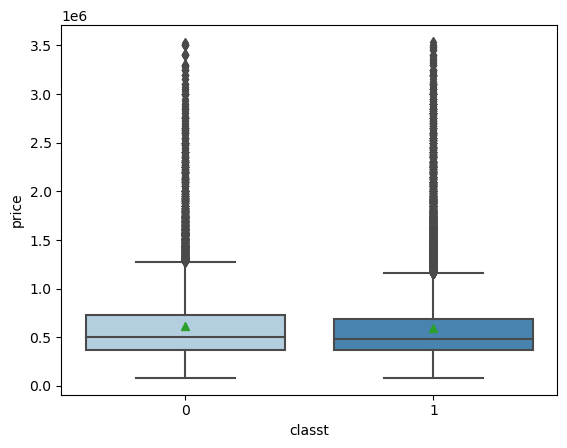

In [15]:
from scipy.stats import ttest_ind
ttest_ind(full.loc[full['classt']==0, 'price'],full.loc[full['classt']==1, 'price'])
# significantly different means in prices between the two outcomes so we choose to keep the variable
ax=sns.boxplot(x='classt', y='price', data=full, palette='Blues', showmeans=True)


In [16]:
import contextily as ctx
from geopandas import GeoDataFrame
import geopandas as gpd
from shapely.geometry import Point

# transforming eastings and northings to coords
full['geometry'] = [Point(xy) for xy in zip(full['Eastings'], full['Northings'])]
gdf = GeoDataFrame(full, geometry='geometry', crs= 27700) 
gdf = gdf.to_crs("EPSG:3857")

# addings stations
# dftube=pd.read_csv('GEOG0115 - ZJXV1/station_locations.txt')
dftube=pd.read_csv('station_locations.txt')
gdftube = gpd.GeoDataFrame(dftube, geometry=gpd.points_from_xy(dftube.longitude, dftube.latitude))
gdftube=gdftube.set_crs(epsg=4326)
gdftube=gdftube.to_crs("EPSG:3857")

# adding schools
#schools = gpd.read_file("GEOG0115 - ZJXV1/Schools in london/school_data_london_2016.shp")
schools = gpd.read_file("Schools in london/school_data_london_2016.shp")
schools = schools['geometry']
schools = gpd.GeoDataFrame(schools)
schools = schools.to_crs("EPSG:3857") # already has crs so no need to set one

In [17]:
# adding point in central london which we consider to be trafalgar square as all distances are measured from there
central = pd.DataFrame([[-0.12806742905920254, 51.50804128349481,]], columns=['longitude', 'latitude'])
gdfcentral = gpd.GeoDataFrame(central, geometry=gpd.points_from_xy(central.longitude, central.latitude))
gdfcentral=gdfcentral.set_crs(epsg=4326)
gdfcentral=gdfcentral.to_crs("EPSG:3857")

In [18]:
schools.shape

(3889, 1)

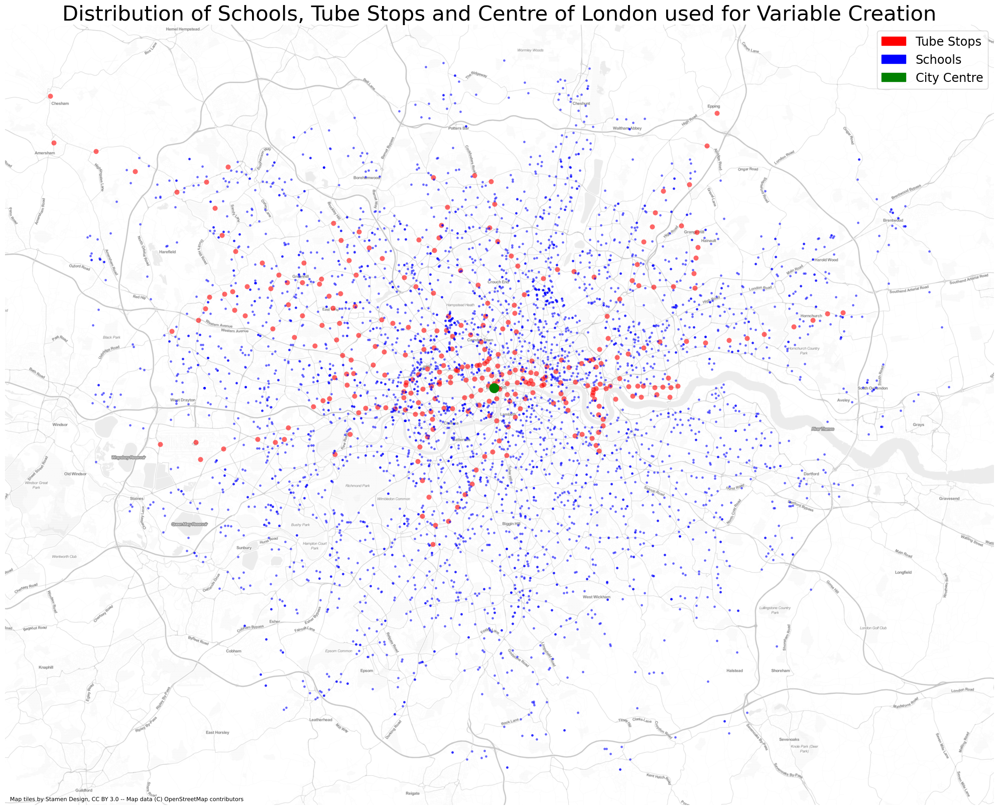

In [19]:
import matplotlib.patches as mpatches

red_patch = mpatches.Patch(color='red', label='Tube Stops')
blue_patch = mpatches.Patch(color='blue', label='Schools')
green_patch = mpatches.Patch(color='green', label='City Centre')
# plotting all three locations in london
fig,ax=plt.subplots(1,1,figsize=(20,20))
# houseplot=gdf.plot(ax=ax,color='black', alpha=0.6, linewidth=0.1, markersize = 20,marker="o")
tubeplot=gdftube.plot(ax=ax,color='red', alpha=0.6, linewidth=0.1, markersize = 50,marker="o")
schoolplot =schools.plot(ax=ax,color='blue', alpha=0.6, linewidth=0.1, markersize = 10,marker="o")
centerplot = gdfcentral.plot(ax=ax, color = 'green', alpha = 1, linewidth = 0.1, markersize= 200, marker="o")
plt.legend(handles=[red_patch, blue_patch, green_patch], handlelength = 2, fontsize = 'xx-large')
# this adds the basemap
ctx.add_basemap(ax, zoom=12, source=ctx.providers.Stamen.TonerLite,alpha=0.5)
ax.set_title("Distribution of Schools, Tube Stops and Centre of London used for Variable Creation",fontsize= 30)
ax.set_axis_off()
fig.tight_layout()
plt.savefig('Dstribution_location_variable_creation')

In [21]:
# adding two more columns for school and tube proximity
# tube chosen above public transport as greater distance travelled with tube
# further improvement can be added with distance weighting for foot travel instead of euclidean distance

def min_distance(point, schools):
    return schools.distance(point).min()
gdf['closest_school'] = gdf.geometry.apply(min_distance, args=(schools,))

def min_distance(point, gdftube):
    return gdftube.distance(point).min()
gdf['closest_tube'] = gdf.geometry.apply(min_distance, args=(gdftube,))

def min_distance(point, gdfcentral):
    return gdfcentral.distance(point).min()
gdf['distance_from_center'] = gdf.geometry.apply(min_distance, args=(gdfcentral,))

gdf = gdf[gdf['closest_school'] < 1730] # remove 130 values
gdf = gdf[gdf['closest_tube'] < 22542] # remove 291 values

(array([ 989., 5145., 7260., 7567., 7395., 9144., 6150., 3659., 1410.,
         563.]),
 array([  484.28765015,  5095.86157373,  9707.4354973 , 14319.00942088,
        18930.58334446, 23542.15726803, 28153.73119161, 32765.30511518,
        37376.87903876, 41988.45296233, 46600.02688591]),
 <BarContainer object of 10 artists>)

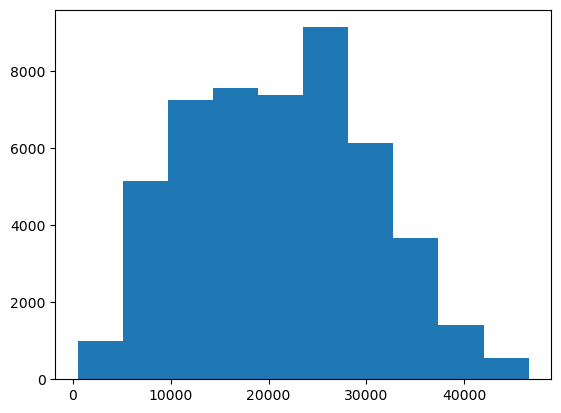

In [22]:
def min_distance(point, gdfcentral):
    return gdfcentral.distance(point).min()
gdf['distance_from_center'] = gdf.geometry.apply(min_distance, args=(gdfcentral,))
plt.hist(gdf['distance_from_center'])

In [23]:
# adding log PPSM and price with the optional display argument
pd.options.display.float_format = '{:,.4f}'.format # adds 4 number decimals
gdf['logPPSM'] = np.log(gdf['PPSM'])
gdf['logPrice'] = np.log(gdf['price'])
# drop useless column of year
gdf = gdf.drop(columns =['year','dateoftransfer',  'classt'])
# gdf = gdf.drop(columns ='POTENTIAL_ENERGY_EFFICIENCY')
gdf_clean = gdf.drop(columns =['Eastings', 'Northings', 'PPSM', 'price'])

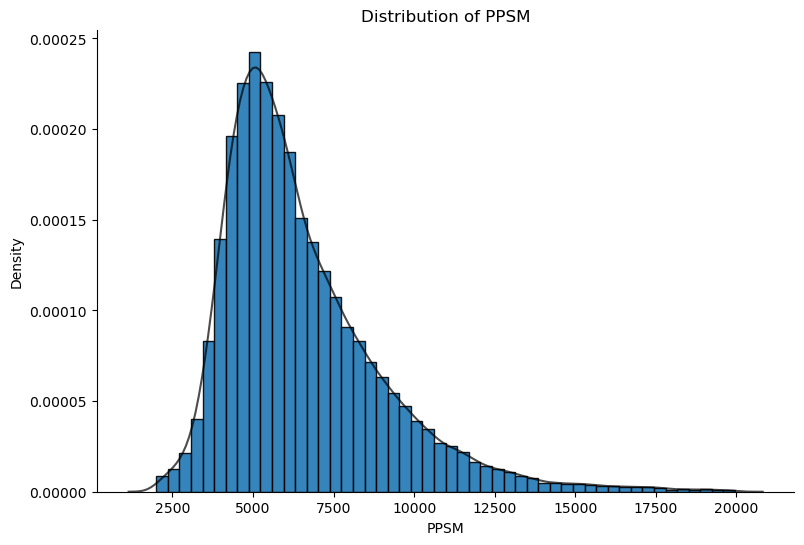

In [24]:
fig, ax= plt.subplots(figsize=(9,6))
sns.distplot(gdf['PPSM'], ax=ax, hist_kws={'alpha': 0.9, 'edgecolor':'black'}, kde_kws={'color': 'black', 'alpha': 0.7}).set(title= 'Distribution of PPSM')
sns.despine()
plt.savefig('PPSM_distribution.png')

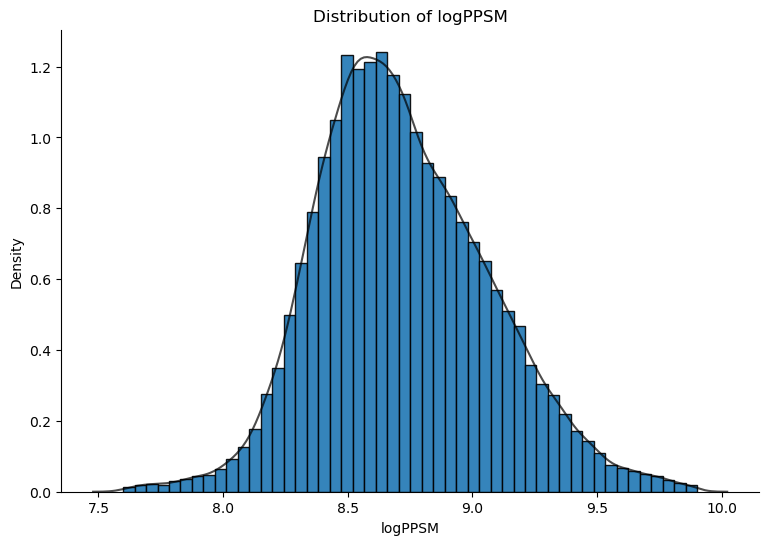

In [25]:
fig, ax= plt.subplots(figsize=(9,6))
sns.distplot(gdf['logPPSM'], ax=ax, hist_kws={'alpha': 0.9, 'edgecolor':'black'}, kde_kws={'color': 'black', 'alpha': 0.7}).set(title= 'Distribution of logPPSM')
sns.despine()
plt.savefig('logPPSM_distribution.png')

In [26]:
# creating dummy variable with one hot encoding for regions and age of the building
one_hot_df = pd.get_dummies(gdf_clean, prefix="region_name", 
                            columns=["region_name"], 
                            drop_first=False)
one_hot_df = pd.get_dummies(one_hot_df, prefix="CONSTRUCTION_AGE_BAND", 
                            columns=["CONSTRUCTION_AGE_BAND"], 
                            drop_first=False)
one_hot_df

,Code,Area_name,propertytype,duration,postcode,lad21cd,transactionid,id,tfarea,numberrooms,CURRENT_ENERGY_EFFICIENCY,POTENTIAL_ENERGY_EFFICIENCY,Postcode,geometry,closest_school,closest_tube,distance_from_center,logPPSM,logPrice,region_name_Central,region_name_East,region_name_North,region_name_South,region_name_West,CONSTRUCTION_AGE_BAND_England and Wales: 1900-1929,CONSTRUCTION_AGE_BAND_England and Wales: 1930-1949,CONSTRUCTION_AGE_BAND_England and Wales: 1950-1966,CONSTRUCTION_AGE_BAND_England and Wales: 1967-1975,CONSTRUCTION_AGE_BAND_England and Wales: 1976-1982,CONSTRUCTION_AGE_BAND_England and Wales: 1983-1990,CONSTRUCTION_AGE_BAND_England and Wales: 1991-1995,CONSTRUCTION_AGE_BAND_England and Wales: 1996-2002,CONSTRUCTION_AGE_BAND_England and Wales: 2003-2006,CONSTRUCTION_AGE_BAND_England and Wales: 2007 onwards,CONSTRUCTION_AGE_BAND_England and Wales: before 1900
0,E09000001,City of London,F,0,EC1A4HU,E09000001,{9FF0D969-6916-11ED-E053-6C04A8C06383},16048588,61.0000,3.0000,77,83,EC1A4HU,POINT (-10824.614 6713492.346),333.5370,382.6659,"3,891.6616",9.4116,13.5225,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
1,E09000001,City of London,F,0,EC1A7AB,E09000001,{B5755FFD-ED44-7D01-E053-6C04A8C036B6},16050681,48.0000,3.0000,77,82,EC1A7AB,POINT (-10995.577 6713705.937),160.3362,188.9718,"3,851.0278",9.5134,13.3847,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
12,E09000001,City of London,F,0,EC1A7BT,E09000001,{AE4D86D4-3DDD-4619-E053-6C04A8C03CD0},16052867,69.0000,3.0000,79,79,EC1A7BT,POINT (-10949.894 6713239.830),570.8560,426.3251,"3,665.7599",9.3583,13.5924,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
13,E09000001,City of London,F,0,EC1A7ES,E09000001,{9FF0D969-FCB3-11ED-E053-6C04A8C06383},16048513,48.0000,2.0000,78,86,EC1A7ES,POINT (-10931.337 6713522.476),351.8946,346.9865,"3,812.5343",9.3465,13.2177,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
14,E09000001,City of London,T,1,EC1A7JQ,E09000001,{A96E4ACC-5EC6-9205-E053-6C04A8C0DA09},16053009,114.3400,5.0000,63,65,EC1A7JQ,POINT (-11106.405 6713639.647),246.2116,308.9436,"3,721.9199",9.6915,14.4307,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60556,E09000033,Westminster,F,0,WC2H8HD,E09000033,{AC07BBCF-D16E-0445-E053-6C04A8C01E31},19013384,43.0000,2.0000,71,80,WC2H8HD,POINT (-14337.533 6712587.428),595.7179,355.9437,933.7888,9.6388,13.4000,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
60557,E09000033,Westminster,F,0,WC2H9SB,E09000033,{A96E4ACC-5F11-9205-E053-6C04A8C0DA09},19076126,94.8700,3.0000,75,81,WC2H9SB,POINT (-13862.345 6712724.827),176.0581,200.2189,"1,138.0556",9.2428,13.7953,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
60558,E09000033,Westminster,F,0,WC2N6EG,E09000033,{B32EBB13-BDBE-3C99-E053-6C04A8C09CA1},18972370,52.0000,3.0000,65,67,WC2N6EG,POINT (-13734.903 6711748.432),848.0278,176.7299,529.4234,9.7644,13.7157,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
60559,E09000033,Westminster,F,0,WC2N6JG,E09000033,{B82222ED-1626-6691-E053-6B04A8C02FB2},19045254,113.0000,4.0000,82,83,WC2N6JG,POINT (-13746.577 6711793.766),802.6783,197.3455,527.8060,9.6449,14.3723,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0


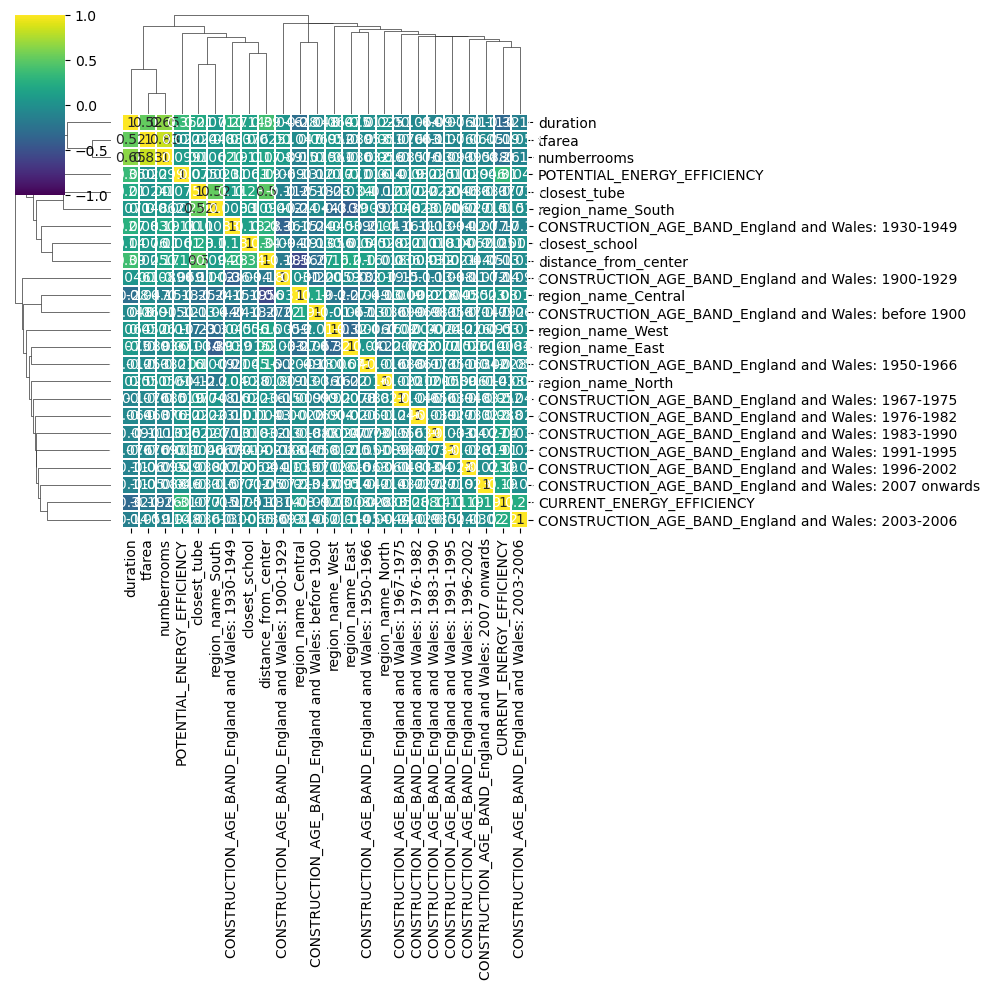

In [27]:
# hierarchically-clustered heatmap of correlation matrix to understand the association between variables
X = one_hot_df.select_dtypes(include=[np.number])
X = X.drop(columns =['id', 'logPPSM','logPrice'])
corr = X.corr()
sns.clustermap(corr, center=0,cmap=plt.get_cmap('viridis'),
            square=True, linewidths=.05, annot=True, vmin=-1, vmax=1) 
plt.show()

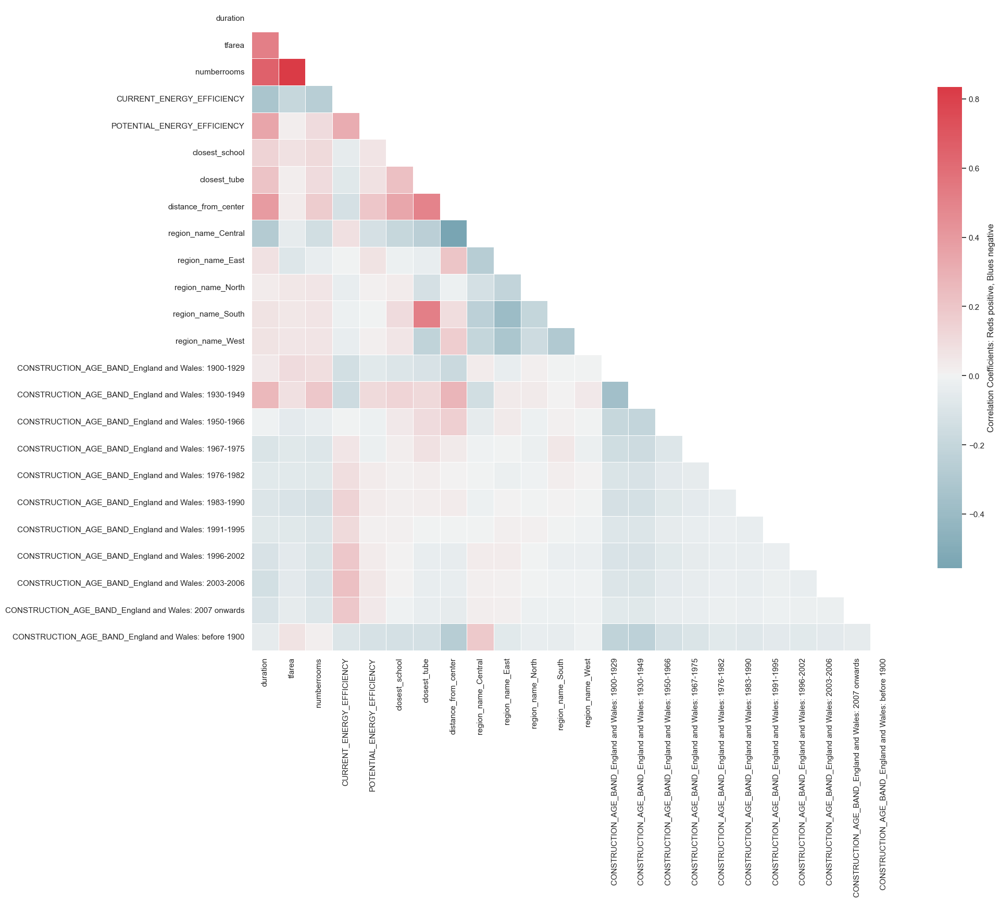

In [28]:
X = one_hot_df.select_dtypes(include=[np.number])
X = X.drop(columns =['id', 'logPPSM','logPrice'])

# as previous heatmap was unclear, we take the following publicly available code from Laura Lewis: https://medium.com/@lvlewis8 ! 
def multi_collinearity_heatmap(df, figsize=(11,9)):
    
    # Set the style of the visualization
    sns.set(style="white")

    # Create a covariance matrix
    corr = X.corr()

    # Generate a mask the size of our covariance matrix
    mask = np.zeros_like(corr, dtype=np.bool)
    mask[np.triu_indices_from(mask)] = True

    # Set up the matplotlib figure
    f, ax = plt.subplots(figsize=figsize)

    # Generate a custom diverging colormap
    cmap = sns.diverging_palette(220, 10, as_cmap=True)

    # Draw the heatmap with the mask and correct aspect ratio
    sns.heatmap(corr, mask=mask, cmap=cmap, center=0, square=True, linewidths=.5, cbar_kws={"shrink": .6, 'label': 'Correlation Coefficients: Reds positive, Blues negative'}, vmax=corr[corr != 1.0].max().max());

multi_collinearity_heatmap(X, figsize=(20,20))
plt.savefig('Correlation_Heatmap.png')

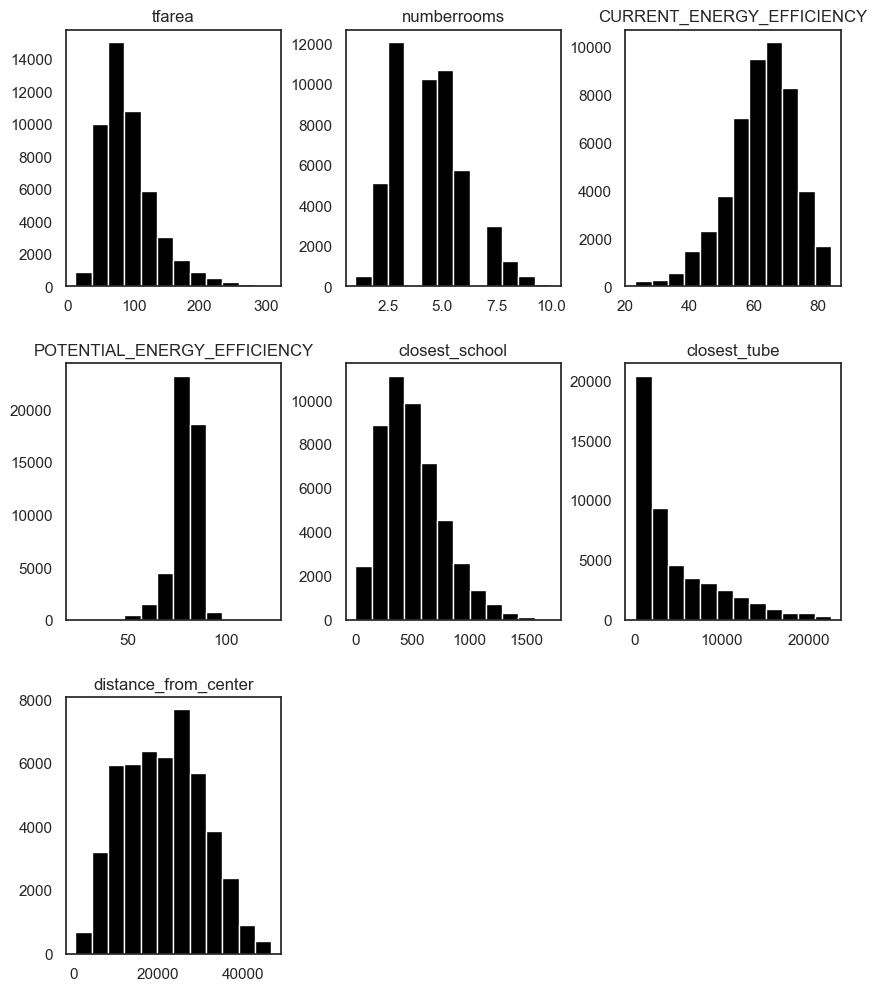

In [29]:
numerical_non_binary = X[X.columns.drop(list(X.filter(regex='CONSTRUCTION')))]
numerical_non_binary = numerical_non_binary[numerical_non_binary.columns.drop(list(numerical_non_binary.filter(regex='region_name')))]
numerical_non_binary = numerical_non_binary.drop(columns=['duration'])
hist = numerical_non_binary.hist(bins=12,color='black',figsize=(10,12),grid=False)

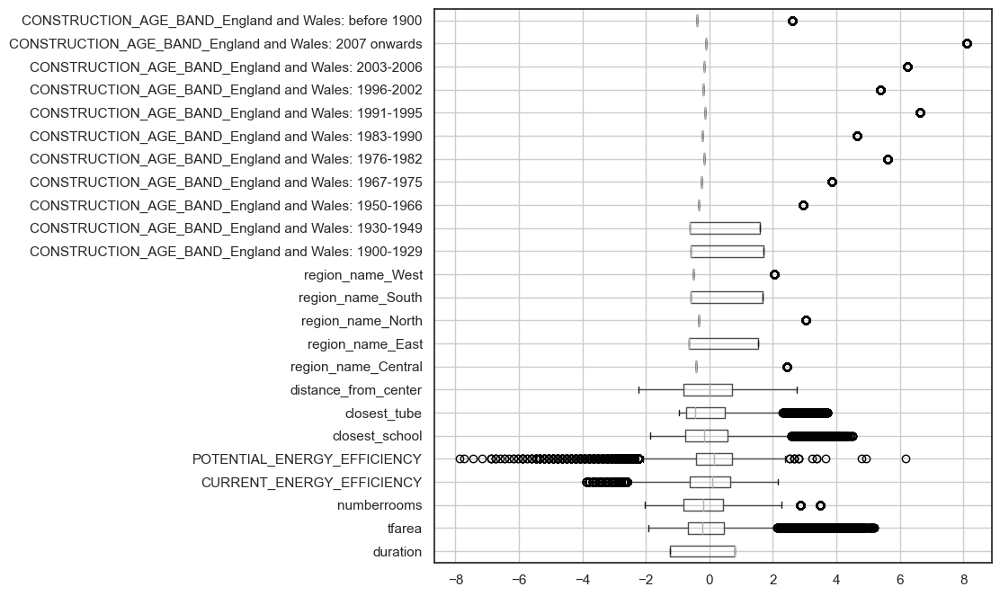

In [31]:
import random
X = one_hot_df.select_dtypes(include=[np.number])
X = X.drop(columns =['id', 'logPPSM','logPrice'])
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaled_X = pd.DataFrame(scaler.fit_transform(X),columns=X.columns)
scaled_X.boxplot(vert=False,figsize=(8,8))
plt.show()
y_logprice = gdf['logPrice']
y_logPPSM = gdf['logPPSM']
## split the dataset and we decide to look at Price per Square meter (PPSM)
random.seed(47)
(X_train, X_test, y_train, y_test) = train_test_split(scaled_X, y_logPPSM, train_size=0.7, random_state=47)

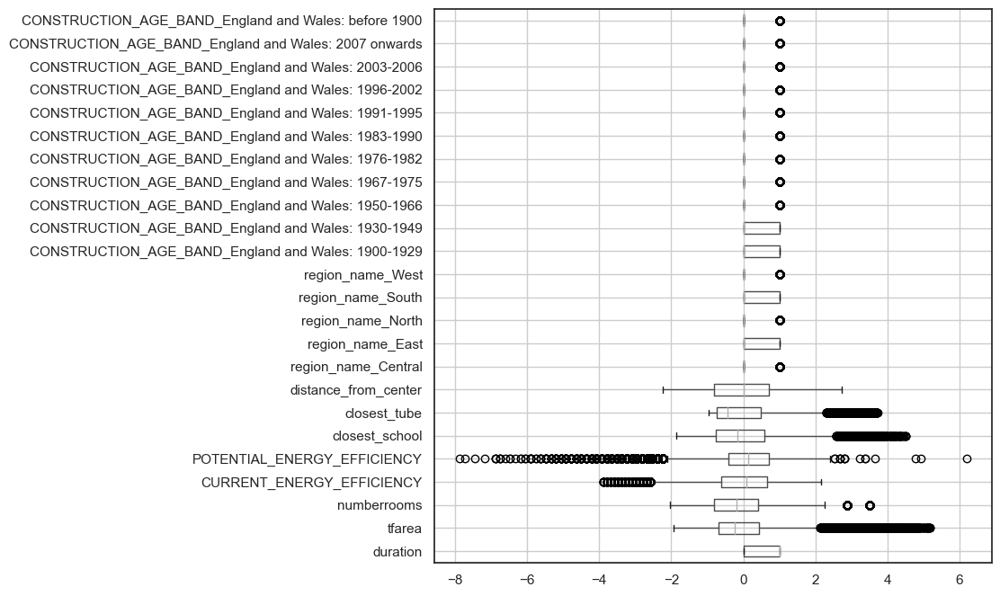

In [32]:
# no need to scale binary variables
scaled_X['CONSTRUCTION_AGE_BAND_England and Wales: 1900-1929'] = one_hot_df['CONSTRUCTION_AGE_BAND_England and Wales: 1900-1929'].values
scaled_X['CONSTRUCTION_AGE_BAND_England and Wales: 1930-1949'] = one_hot_df['CONSTRUCTION_AGE_BAND_England and Wales: 1930-1949'].values
scaled_X['CONSTRUCTION_AGE_BAND_England and Wales: 1950-1966'] = one_hot_df['CONSTRUCTION_AGE_BAND_England and Wales: 1950-1966'].values
scaled_X['CONSTRUCTION_AGE_BAND_England and Wales: 1967-1975'] = one_hot_df['CONSTRUCTION_AGE_BAND_England and Wales: 1967-1975'].values
scaled_X['CONSTRUCTION_AGE_BAND_England and Wales: 1976-1982'] = one_hot_df['CONSTRUCTION_AGE_BAND_England and Wales: 1976-1982'].values
scaled_X['CONSTRUCTION_AGE_BAND_England and Wales: 1983-1990'] = one_hot_df['CONSTRUCTION_AGE_BAND_England and Wales: 1983-1990'].values
scaled_X['CONSTRUCTION_AGE_BAND_England and Wales: 1991-1995'] = one_hot_df['CONSTRUCTION_AGE_BAND_England and Wales: 1991-1995'].values
scaled_X['CONSTRUCTION_AGE_BAND_England and Wales: 1996-2002'] = one_hot_df['CONSTRUCTION_AGE_BAND_England and Wales: 1996-2002'].values
scaled_X['CONSTRUCTION_AGE_BAND_England and Wales: 2003-2006'] = one_hot_df['CONSTRUCTION_AGE_BAND_England and Wales: 2003-2006'].values
scaled_X['CONSTRUCTION_AGE_BAND_England and Wales: 2007 onwards'] = one_hot_df['CONSTRUCTION_AGE_BAND_England and Wales: 2007 onwards'].values
scaled_X['CONSTRUCTION_AGE_BAND_England and Wales: before 1900'] = one_hot_df['CONSTRUCTION_AGE_BAND_England and Wales: before 1900'].values
scaled_X['region_name_Central'] = one_hot_df['region_name_Central'].values
scaled_X['region_name_West'] = one_hot_df['region_name_West'].values
scaled_X['region_name_South'] = one_hot_df['region_name_South'].values
scaled_X['region_name_North'] = one_hot_df['region_name_North'].values
scaled_X['region_name_East'] = one_hot_df['region_name_East'].values
# scaled_X['classt'] = one_hot_df['classt'].values
scaled_X['duration'] = one_hot_df['duration'].values
scaled_X.boxplot(vert=False,figsize=(8,8))
plt.show()
y_logprice = gdf['logPrice']
y_logPPSM = gdf['logPPSM']
## split the dataset and we decide to look at Price per Square meter (PPSM)
(X_train, X_test, y_train, y_test) = train_test_split(scaled_X, y_logPPSM, train_size=0.7, random_state=47)


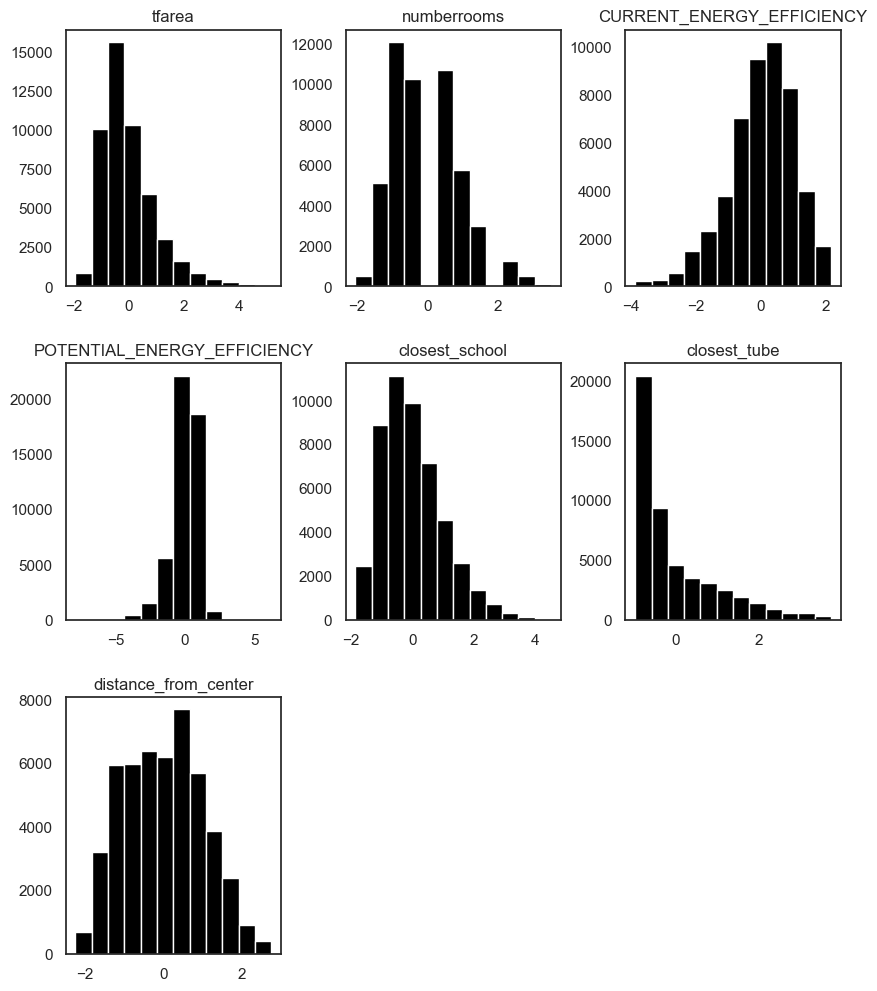

In [78]:
numerical_non_binary = scaled_X[scaled_X.columns.drop(list(scaled_X.filter(regex='CONSTRUCTION')))]
numerical_non_binary = numerical_non_binary[numerical_non_binary.columns.drop(list(numerical_non_binary.filter(regex='region_name')))]
numerical_non_binary = numerical_non_binary.drop(columns=['duration'])
hist = numerical_non_binary.hist(bins=12,color='black',figsize=(10,12),grid=False)
plt.savefig('variable_overview.png')

In [33]:
scaled_X.shape
y_logPPSM.shape

(49282,)

In [35]:
# initiating basic linear regression model
model=LinearRegression()
model.fit(X_train,y_train)

#testing set
columns=['Test RMSE', 'Test R2', 'Test MSE']
rows=['Linear Regression']
results=pd.DataFrame(0.0, columns=columns, index=rows) 

methods=[model]

for i, method in enumerate(methods):

    y_pred=method.predict(X_test)
    
    results.iloc[i,0] = (mean_squared_error(y_test, y_pred, squared = False))
    results.iloc[i,1] = r2_score(y_test, y_pred)
    results.iloc[i,2] = mean_squared_error(y_test, y_pred)

results

,Test RMSE,Test R2,Test MSE
Linear Regression,0.2524,0.4768,0.0637


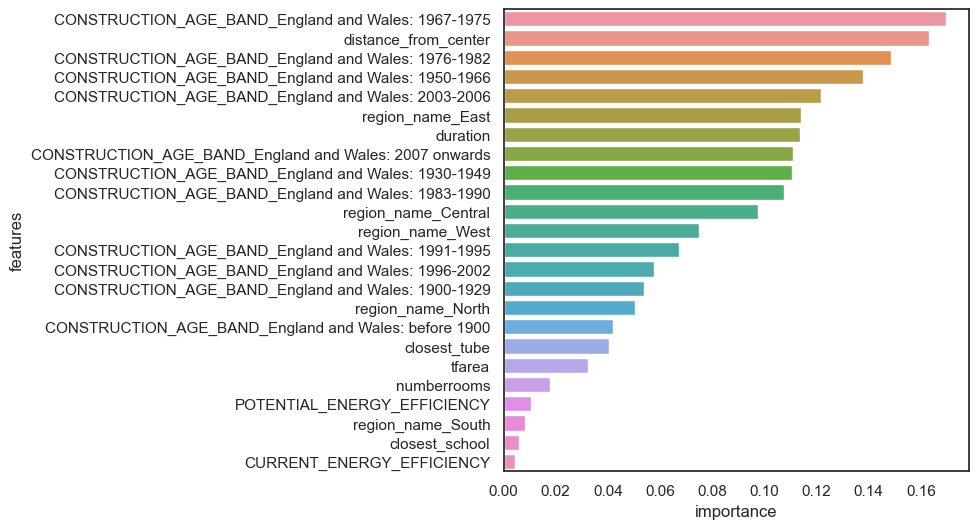

In [36]:
# you can then easily plot out feature importance for variables in descending order
coef = pd.DataFrame(model.coef_, index = X.columns)
coef = coef.reset_index()
coef.columns=['features','importance']
coef['importance']=np.abs(coef['importance'])
coef=coef.sort_values(by='importance',ascending=False)
plt.figure(figsize=(6,6))

sns.barplot(x='importance',y='features',data=coef,)
plt.show()

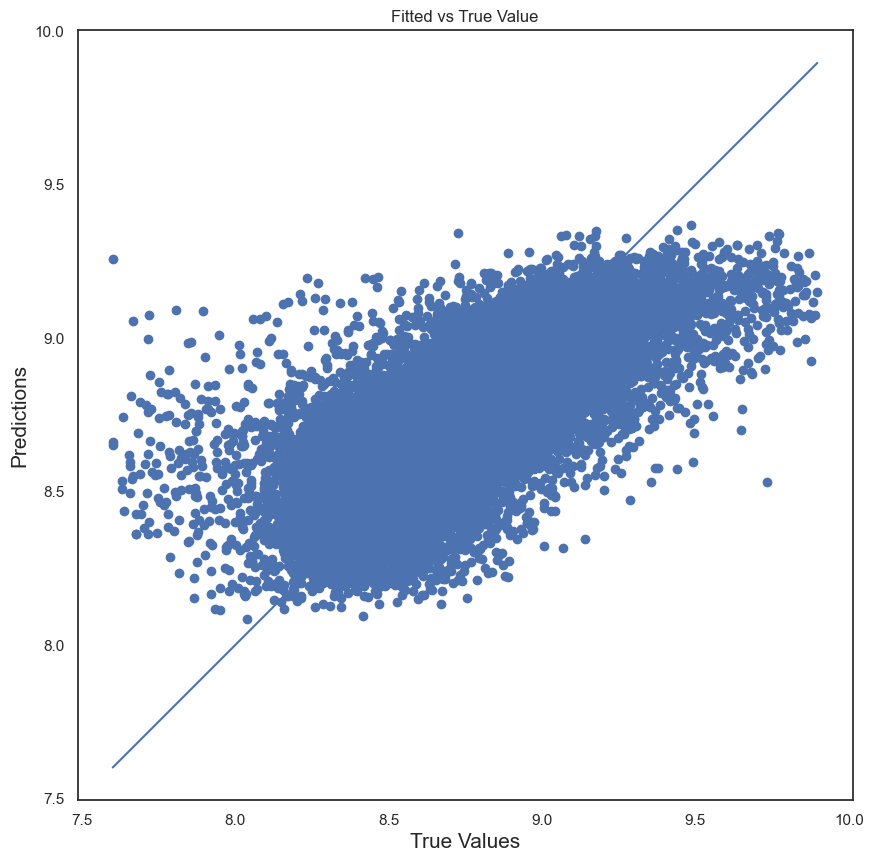

In [37]:
plt.figure(figsize=(10,10))
plt.scatter(y_test ,model.predict(X_test))
plt.xlabel('PPSM', fontsize=10)
plt.ylabel('Gradient Boosting', fontsize=10)
plt.title('Fitted vs True Value')

p1 = max(max(model.predict(X_test)), max(y_test))
p2 = min(min(model.predict(X_test)), min(y_test))
plt.plot([p1, p2], [p1, p2], 'b-')
plt.xlabel('True Values', fontsize=15)
plt.ylabel('Predictions', fontsize=15)
plt.axis('equal')
plt.show()

In [38]:
# now applying a Lasso model where parameters set by cross-validation
from sklearn import linear_model
model2 = linear_model.Lasso()
# Set the parameters by cross-validation
tuned_parameters = [{'alpha': [1e-1,1e-2,1e-3,1e-4,1e-5,1e-6]}]
### Grid Search cross validation
from sklearn.model_selection import GridSearchCV
LASSO_GridSearch = GridSearchCV(model2, tuned_parameters, cv=2, scoring='r2')
LASSO_GridSearch.fit(X_train, y_train)
print ("Best Score: {}".format(LASSO_GridSearch.best_score_))
print ("Best params: {}".format(LASSO_GridSearch.best_params_))

model2 = linear_model.Lasso(alpha=0.000001)
model2.fit(X_train,y_train)


Best Score: 0.46542222844687925
Best params: {'alpha': 1e-05}


Lasso(alpha=1e-06)

In [39]:
#testing set
columns=['Test RMSE', 'Test R2', 'Test MSE']
rows=['Lasso']
results=pd.DataFrame(0.0, columns=columns, index=rows) 

methods=[model2]

for i, method in enumerate(methods):

    y_pred=method.predict(X_test)
    
    results.iloc[i,0] = (mean_squared_error(y_test, y_pred, squared = False))
    results.iloc[i,1] = r2_score(y_test, y_pred)
    results.iloc[i,2] = mean_squared_error(y_test, y_pred)

results.round(5)

,Test RMSE,Test R2,Test MSE
Lasso,0.2524,0.4768,0.0637


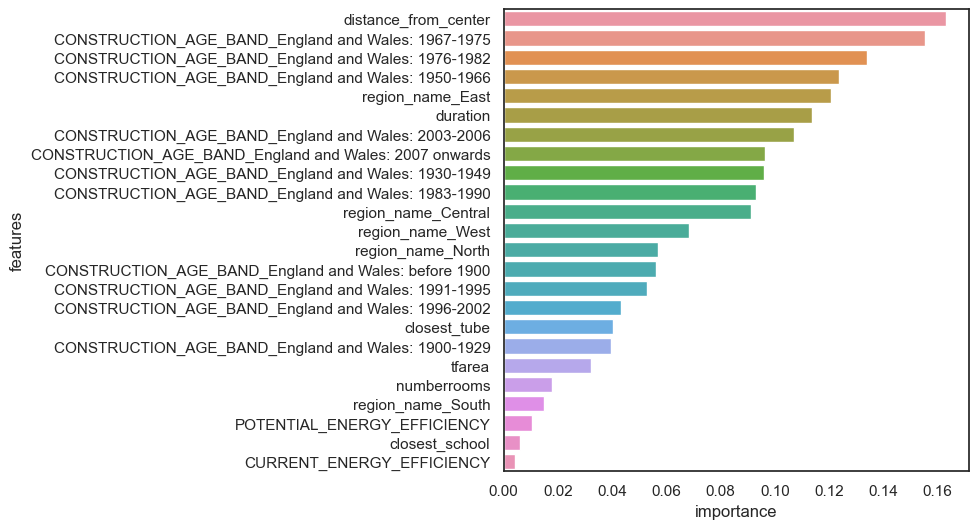

In [40]:
# you can then easily plot out feature importance for variables in descending order
coef = pd.DataFrame(model2.coef_, index = X.columns)
coef = coef.reset_index()
coef.columns=['features','importance']
coef['importance']=np.abs(coef['importance'])
coef=coef.sort_values(by='importance',ascending=False)
plt.figure(figsize=(6,6))

sns.barplot(x='importance',y='features',data=coef,)
plt.show()

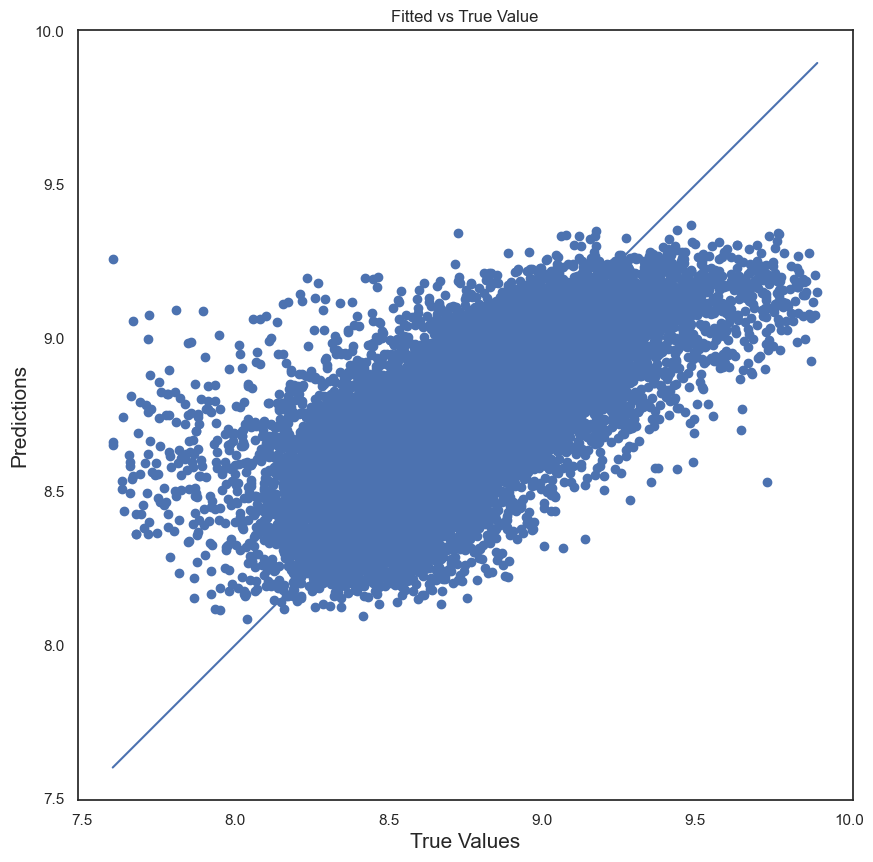

In [41]:
plt.figure(figsize=(10,10))
plt.scatter(y_test ,model2.predict(X_test))
plt.xlabel('PPSM', fontsize=10)
plt.ylabel('Gradient Boosting', fontsize=10)
plt.title('Fitted vs True Value')

p1 = max(max(model2.predict(X_test)), max(y_test))
p2 = min(min(model2.predict(X_test)), min(y_test))
plt.plot([p1, p2], [p1, p2], 'b-')
plt.xlabel('True Values', fontsize=15)
plt.ylabel('Predictions', fontsize=15)
plt.axis('equal')
plt.show()

In [42]:
# gradient boosting model
# model takes a long time to run so best estimators found are provided below
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
# %%time

# model = GradientBoostingRegressor()

#tuning_parameters = {
#    'learning_rate': [0.01, 0.05, 0.1],
#    'n_estimators' : [250, 500, 750, 1000, 1500, 2000],
#    'max_depth' : [2 ,3, 4],
#    'subsample' : [0.6, 0.8, 1.0]
#}

# gb = RandomizedSearchCV(model, tuning_parameters, n_iter = 32, cv = 5, n_jobs=4, random_state=87)
# gb.fit(X_train, y_train)

# print('Best parameters found by randomised search:', gb.best_params_, '\n')
# gb.best_estimator_
# according to previous results should take approx. 2h22min run-time
# if this unsuccessful, Best parameters found by randomised search: {'subsample': 0.8, 'n_estimators': 1500, 'max_depth': 4, 'learning_rate': 0.05}

In [43]:
gb = GradientBoostingRegressor(learning_rate=0.05, max_depth=4, n_estimators=1500, subsample=0.8)
gb.fit(X_train, y_train)

GradientBoostingRegressor(learning_rate=0.05, max_depth=4, n_estimators=1500,
                          subsample=0.8)

In [83]:
# Alternatively, we can also choose to plot feature importance with this function, making it easier when discussing future models
# we take no credit for this function, taken from the statlearning package
# source code publicly available here: https://github.com/mscharth/qbus6810/blob/master/statlearning.py
# author is Marcel Sharth and this function was taken because we liked the output
def plot_feature_importance(model, labels, max_features = 20):
    feature_importance = model.feature_importances_*100
    feature_importance = 100*(feature_importance/np.max(feature_importance))
    table = pd.Series(feature_importance, index = labels).sort_values(ascending=True, inplace=False)
    fig, ax = fig, ax = plt.subplots(figsize=(20,16))
    if len(table) > max_features:
        table.iloc[-max_features:].T.plot(kind='barh', edgecolor='black', width=0.7, linewidth=.8, alpha=0.9, ax=ax)
    else:
        table.T.plot(kind='barh', edgecolor='black', width=0.7, linewidth=.8, alpha=0.9, ax=ax)
    ax.tick_params(axis=u'y', length=0) 
    ax.set_title('Variable importance', fontsize=13)
    sns.despine()
    return fig, ax

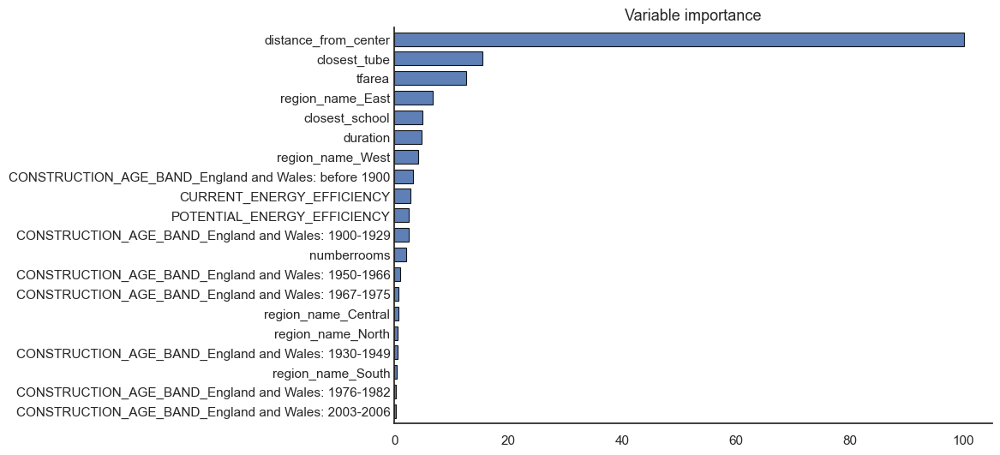

In [45]:
# plotting feature importance
# plot_feature_importance(gb.best_estimator_, X_train.columns)
plot_feature_importance(gb, X_train.columns)
plt.show()

In [46]:
#training set
columns=['Train RMSE', 'Train R2', 'Train MSE']
rows=['Gradient boost']
results=pd.DataFrame(0.0, columns=columns, index=rows) 

methods=[gb]

for i, method in enumerate(methods):

    y_pred=method.predict(X_train)
    
    results.iloc[i,0] = (mean_squared_error(y_train, y_pred, squared = False))
    results.iloc[i,1] = r2_score(y_train, y_pred)
    results.iloc[i,2] = mean_squared_error(y_train, y_pred)

results.round(4)
# gradient boost gives us: Train RMSE at 0.2120, Train R2 at 0.6260 (when not including distance from center)

,Train RMSE,Train R2,Train MSE
Gradient boost,0.1811,0.7273,0.0328


In [47]:
#testing set
columns=['Test RMSE', 'Test R2', 'Test MSE']
rows=['Gradient boost']
results=pd.DataFrame(0.0, columns=columns, index=rows) 

methods=[gb]

for i, method in enumerate(methods):

    y_pred=method.predict(X_test)
    
    results.iloc[i,0] = (mean_squared_error(y_test, y_pred, squared = False))
    results.iloc[i,1] = r2_score(y_test, y_pred)
    results.iloc[i,2] = mean_squared_error(y_test, y_pred)

results.round(5)
# gradient boost gives us considerable increase in R squared compared to lasso regression, from 0.39 to 0.64

,Test RMSE,Test R2,Test MSE
Gradient boost,0.2102,0.6371,0.0442


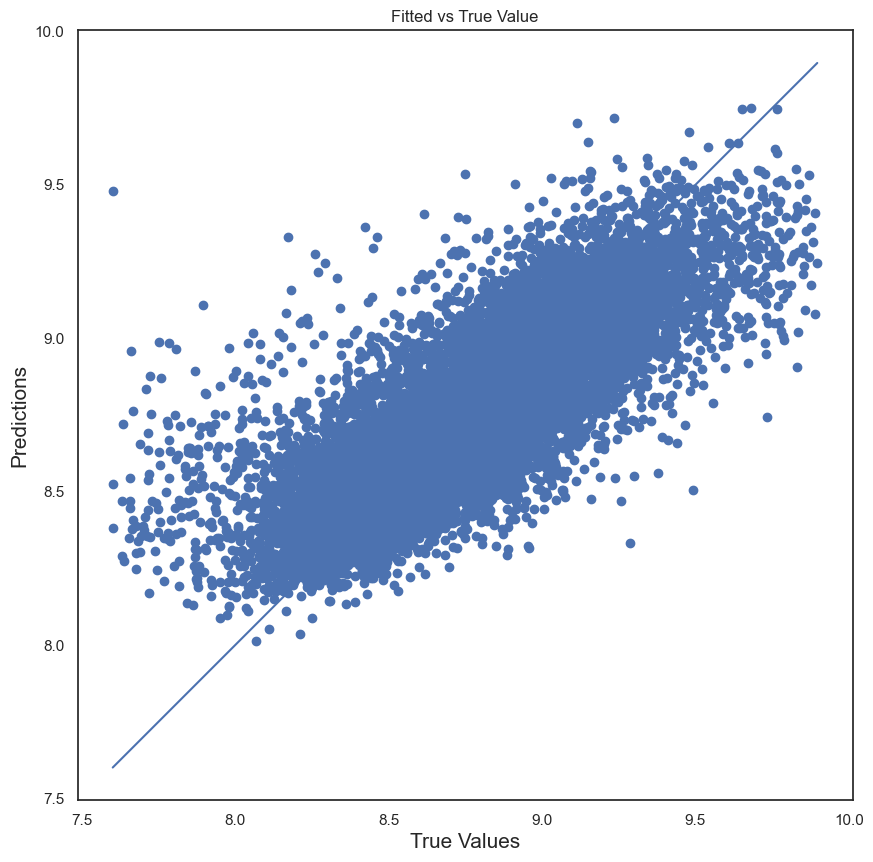

In [48]:
plt.figure(figsize=(10,10))
plt.scatter(y_test ,gb.predict(X_test))
plt.xlabel('PPSM', fontsize=10)
plt.ylabel('Gradient Boosting', fontsize=10)
plt.title('Fitted vs True Value')

p1 = max(max(gb.predict(X_test)), max(y_test))
p2 = min(min(gb.predict(X_test)), min(y_test))
plt.plot([p1, p2], [p1, p2], 'b-')
plt.xlabel('True Values', fontsize=15)
plt.ylabel('Predictions', fontsize=15)
plt.axis('equal')
plt.show()

In [49]:
#%%time
# supported from code found at https://www.analyticsvidhya.com/blog/2016/03/complete-guide-parameter-tuning-xgboost-with-codes-python/
# published by Aarshay Jain
# Now moving on to XGBoost model
# same methodology followed at gradient boosting resutls

#model = xgb.XGBRegressor(objective='reg:squarederror', reg_lambda=0)

#tuning_parameters = {
#    'learning_rate': [0.01, 0.05, 0.1],
#    'n_estimators' : [250, 500, 750, 1000, 1500, 2000],
#    'max_depth' : [2,3,4],
#    'subsample' : [0.6, 0.8, 1.0]
#}


#xbst = RandomizedSearchCV(model, tuning_parameters, n_iter = 32, cv = 5, random_state=87, n_jobs=4)
#xbst.fit(X_train, y_train)

# print('Best parameters found by randomised search:', xbst.best_params_, '\n')

# xbst=xbst.best_estimator_

In [50]:
xbst = xgb.XGBRegressor(learning_rate=0.05, max_depth=4, n_estimators=1500, subsample=0.8)
xbst.fit(X_train, y_train)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.05, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=4, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             n_estimators=1500, n_jobs=None, num_parallel_tree=None,
             predictor=None, random_state=None, ...)

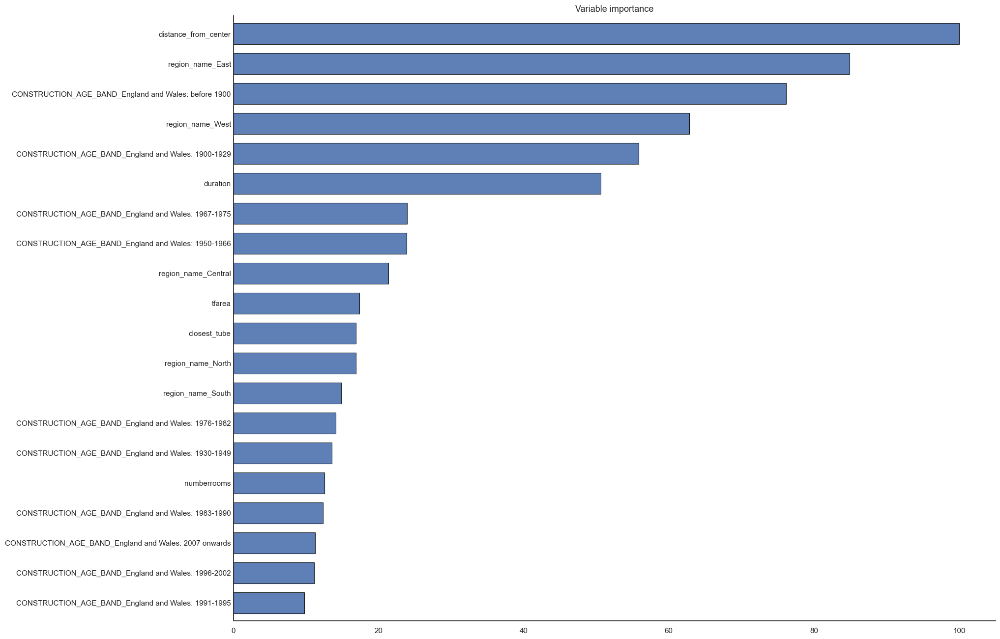

In [84]:

plot_feature_importance(xbst, X_train.columns)
plt.savefig('Variable_importance_XGBT.png')

In [52]:
#Training set
columns=['Train RMSE', 'Train R2', 'Train MSE']
rows=['XGBoost']
results=pd.DataFrame(0.0, columns=columns, index=rows) 

methods=[xbst]

for i, method in enumerate(methods):

    y_pred=method.predict(X_train)

    results.iloc[i,0] = (mean_squared_error(y_train, y_pred, squared = False))
    results.iloc[i,1] = r2_score(y_train, y_pred)
    results.iloc[i,2] = mean_absolute_error(y_train, y_pred)

results.round(4)

,Train RMSE,Train R2,Train MSE
XGBoost,0.1841,0.7183,0.1365


In [53]:
#Testing set
columns=['Test RMSE', 'Test R2', 'Test MSE']
rows=['XGBoost']
results=pd.DataFrame(0.0, columns=columns, index=rows) 

methods=[xbst]

for i, method in enumerate(methods):

    y_pred=method.predict(X_test)

    results.iloc[i,0] = (mean_squared_error(y_test, y_pred, squared = False))
    results.iloc[i,1] = r2_score(y_test, y_pred)
    results.iloc[i,2] = mean_absolute_error(y_test, y_pred)

results.round(4)

,Test RMSE,Test R2,Test MSE
XGBoost,0.2099,0.6382,0.1546


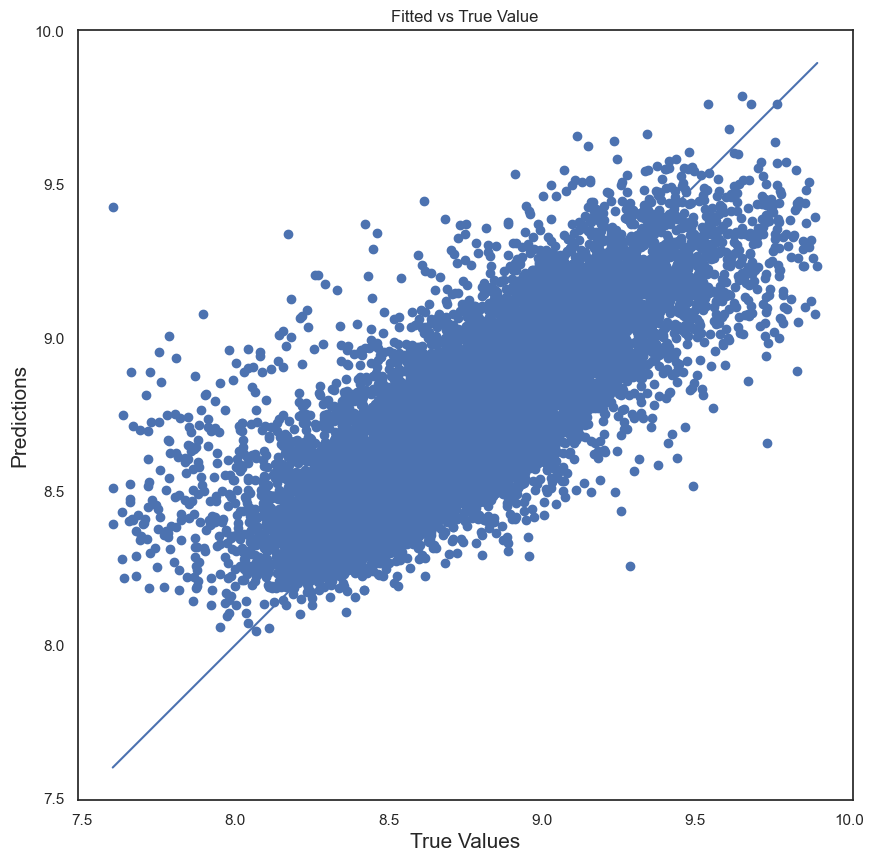

In [54]:
plt.figure(figsize=(10,10))
plt.scatter(y_test ,xbst.predict(X_test))
plt.xlabel('PPSM', fontsize=10)
plt.ylabel('Gradient Boosting', fontsize=10)
plt.title('Fitted vs True Value')

p1 = max(max(xbst.predict(X_test)), max(y_test))
p2 = min(min(xbst.predict(X_test)), min(y_test))
plt.plot([p1, p2], [p1, p2], 'b-')
plt.xlabel('True Values', fontsize=15)
plt.ylabel('Predictions', fontsize=15)
plt.axis('equal')
plt.show()

In [55]:
#Testing set all methods together
columns=['Test RMSE', 'Test R2', 'Test MSE']
rows=['Linear Regression', 'Lasso Regression', 'Gradient Boosting', 'XGBoost']
results=pd.DataFrame(0.0, columns=columns, index=rows) 

methods = [model, model2, gb, xbst]

for i, method in enumerate(methods):

    y_pred=method.predict(X_test)
    
    results.iloc[i,0] = (mean_squared_error(y_test, y_pred, squared=False))
    results.iloc[i,1] = r2_score(y_test, y_pred)
    results.iloc[i,2] = mean_absolute_error(y_test, y_pred)

results.round(4)

,Test RMSE,Test R2,Test MSE
Linear Regression,0.2524,0.4768,0.1928
Lasso Regression,0.2524,0.4768,0.1928
Gradient Boosting,0.2102,0.6371,0.1549
XGBoost,0.2099,0.6382,0.1546


In [56]:
#Testing set all methods together (for training subsets)
columns=['Train RMSE', 'Train R2', 'Train MSE']
rows=['Linear Regression', 'Lasso Regression', 'Gradient Boosting', 'XGBoost']
results=pd.DataFrame(0.0, columns=columns, index=rows) 

methods = [model, model2, gb, xbst]

for i, method in enumerate(methods):

    y_pred=method.predict(X_train)
    
    results.iloc[i,0] = (mean_squared_error(y_train, y_pred, squared=False))
    results.iloc[i,1] = r2_score(y_train, y_pred)
    results.iloc[i,2] = mean_absolute_error(y_train, y_pred)

results.round(4)

,Train RMSE,Train R2,Train MSE
Linear Regression,0.2533,0.4665,0.1933
Lasso Regression,0.2533,0.4665,0.1933
Gradient Boosting,0.1811,0.7273,0.1355
XGBoost,0.1841,0.7183,0.1365


In [57]:
# gets all the test set logPPSM values
df1 = gdf[~gdf.index.isin(y_train.index)]
df1

,Code,Area_name,propertytype,duration,price,postcode,lad21cd,transactionid,id,tfarea,numberrooms,CURRENT_ENERGY_EFFICIENCY,POTENTIAL_ENERGY_EFFICIENCY,CONSTRUCTION_AGE_BAND,Postcode,Eastings,Northings,PPSM,region_name,geometry,closest_school,closest_tube,distance_from_center,logPPSM,logPrice
14,E09000001,City of London,T,1,1850000,EC1A7JQ,E09000001,{A96E4ACC-5EC6-9205-E053-6C04A8C0DA09},16053009,114.3400,5.0000,63,65,England and Wales: 1983-1990,EC1A7JQ,531940,181734,"16,179.8146",Central,POINT (-11106.405 6713639.647),246.2116,308.9436,"3,721.9199",9.6915,14.4307
17,E09000001,City of London,F,0,604250,EC1A9LS,E09000001,{B5755FFE-3884-7D01-E053-6C04A8C036B6},16050286,59.0000,2.0000,75,85,England and Wales: 1996-2002,EC1A9LS,531738,181564,"10,241.5254",Central,POINT (-11437.375 6713374.776),651.6395,553.8973,"3,301.0719",9.2342,13.3117
21,E09000001,City of London,F,0,425000,EC1Y0SN,E09000001,{9DBAD222-02FD-6EB3-E053-6B04A8C0F257},16050552,39.0000,1.0000,67,72,England and Wales: 1967-1975,EC1Y0SN,532096,182112,"10,897.4359",Central,POINT (-10840.503 6714240.847),68.1977,377.4051,"4,282.9590",9.2963,12.9598
23,E09000001,City of London,F,0,575000,EC2M4NR,E09000001,{9DBAD222-02E9-6EB3-E053-6B04A8C0F257},16047932,46.0000,2.0000,68,76,England and Wales: 1996-2002,EC2M4NR,533334,181640,"12,500.0000",Central,POINT (-8875.138 6713430.028),751.2390,287.7527,"5,665.7757",9.4335,13.2621
28,E09000001,City of London,F,0,795000,EC2Y8BD,E09000001,{A71375FD-D62F-7576-E053-6C04A8C0462F},16053069,76.0000,2.0000,71,74,England and Wales: 1900-1929,EC2Y8BD,532402,181753,"10,460.5263",Central,POINT (-10364.808 6713650.871),163.6767,512.7699,"4,372.5664",9.2554,13.5861
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60504,E09000033,Westminster,F,0,540000,W93TZ,E09000033,{B0A9D11B-A26C-4C1F-E053-6C04A8C0D716},18988490,77.0000,3.0000,72,81,England and Wales: 2003-2006,W93TZ,525266,181904,"7,012.9870",Central,POINT (-21801.744 6714184.563),375.7178,620.9584,"7,957.3809",8.8555,13.1993
60505,E09000033,Westminster,F,0,425000,W93TZ,E09000033,{B82222ED-1697-6691-E053-6B04A8C02FB2},18987960,51.0000,2.0000,68,81,England and Wales: 1976-1982,W93TZ,525266,181904,"8,333.3333",Central,POINT (-21801.744 6714184.563),375.7178,620.9584,"7,957.3809",9.0280,12.9598
60550,E09000033,Westminster,F,0,1440000,WC2B4RL,E09000033,{9FF0D969-FC89-11ED-E053-6C04A8C06383},19046596,110.0000,4.0000,54,59,England and Wales: 1996-2002,WC2B4RL,530449,181204,"13,090.9091",Central,POINT (-13519.026 6712849.510),271.3332,453.4687,"1,401.9254",9.4797,14.1802
60555,E09000033,Westminster,F,0,610000,WC2H7PS,E09000033,{B5755FFD-B853-7D01-E053-6C04A8C036B6},19005819,54.0000,4.0000,77,77,England and Wales: 1983-1990,WC2H7PS,529919,180928,"11,296.2963",Central,POINT (-14380.111 6712427.668),591.4674,222.7779,780.3656,9.3322,13.3212


In [58]:
df1.logPPSM.describe()

count   14,785.0000
mean         8.7261
std          0.3489
min          7.6009
25%          8.4802
50%          8.6926
75%          8.9493
max          9.8971
Name: logPPSM, dtype: float64

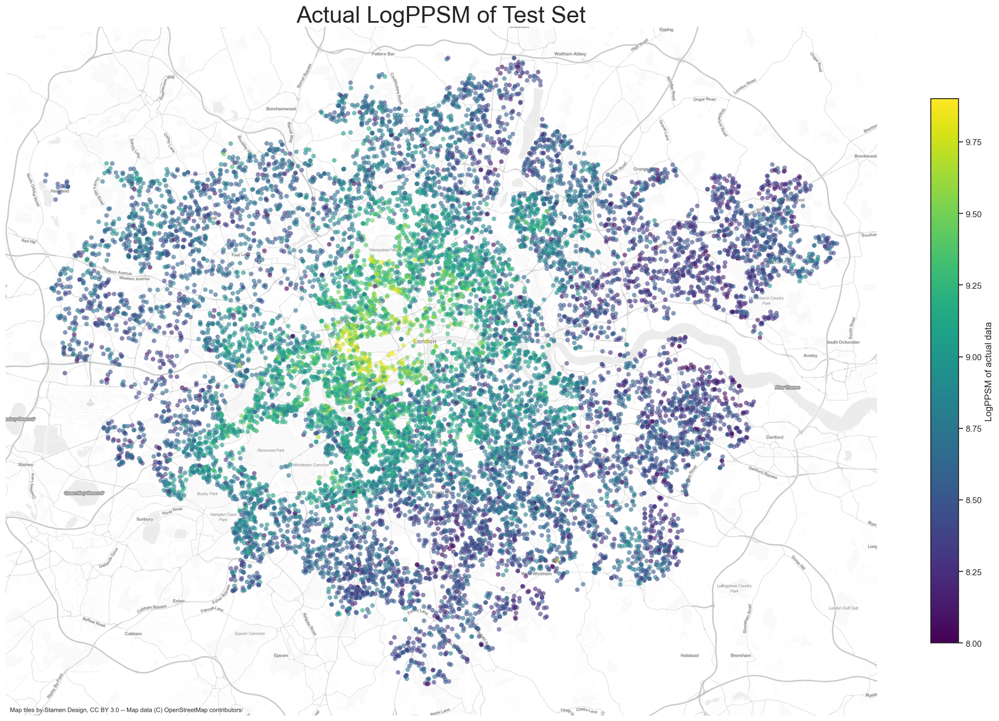

In [59]:
# this sets an empty fig and axis 
fig,ax = plt.subplots(1,1,figsize=[20,20])

# plot with geopandas.dataframe.plot
myplot=df1.plot(figsize=(20, 20), alpha=0.6, linewidth=0.1,
                edgecolor='w',ax=ax,
            column='logPPSM',legend=True,vmin = 8, vmax=9.90,cmap='viridis',
           legend_kwds={'label': "LogPPSM of actual data",'shrink': 0.5})

# this adds the basemap
ctx.add_basemap(ax, zoom=12, source=ctx.providers.Stamen.TonerLite,alpha=0.5)

# this sets the title
ax.set_title("Actual LogPPSM of Test Set",fontsize= 30)

# this removes the axis
ax.set_axis_off()

# this tightens the layout
fig.tight_layout()

plt.savefig('Actual_distribution_PPSM_test.png')

In [60]:
# now making the same plot with the predictive results from models, XBST as best
y_pred=xbst.predict(X_test)
y_pred.dtype

dtype('float32')

In [61]:
df1['predicted_XGBoost_logPPSM']=y_pred.tolist()
print(df1.predicted_XGBoost_logPPSM.describe())
print(df1.logPPSM.describe())


count   14,785.0000
mean         8.7230
std          0.2728
min          8.0447
25%          8.5139
50%          8.6742
75%          8.9081
max          9.7887
Name: predicted_XGBoost_logPPSM, dtype: float64
count   14,785.0000
mean         8.7261
std          0.3489
min          7.6009
25%          8.4802
50%          8.6926
75%          8.9493
max          9.8971
Name: logPPSM, dtype: float64


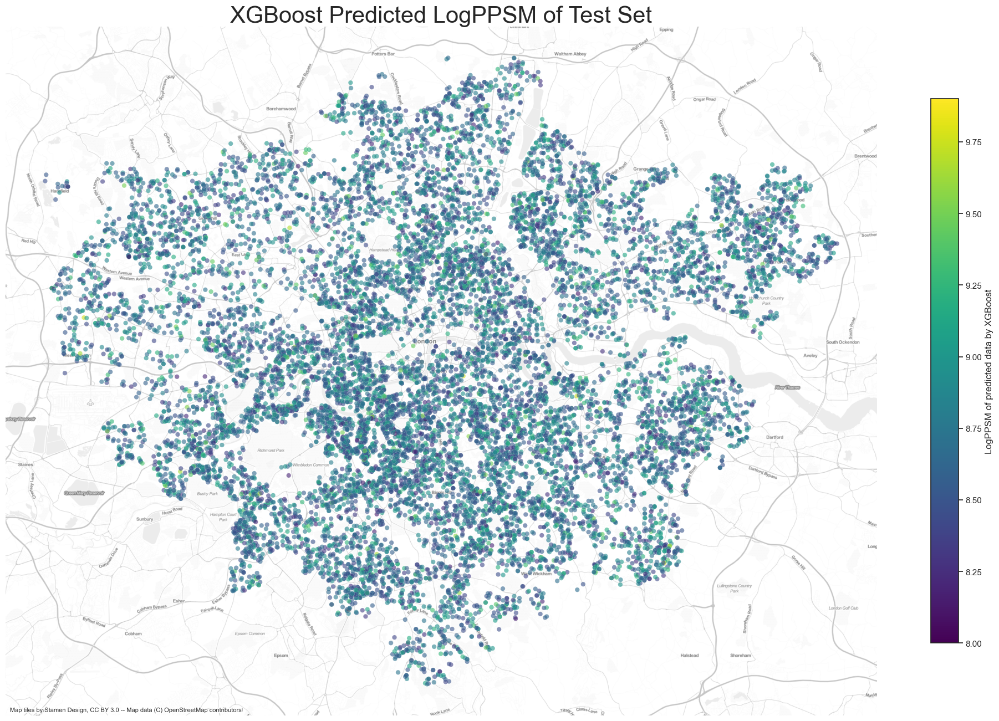

In [62]:
# this sets an empty fig and axis 
fig,ax = plt.subplots(1,1,figsize=[20,20])

# plot with geopandas.dataframe.plot
myplot=df1.plot(figsize=(20, 20), alpha=0.6, linewidth=0.1,
                edgecolor='w',ax=ax,
            column='predicted_XGBoost_logPPSM',legend=True, vmin = 8, vmax=9.90,cmap='viridis',
           legend_kwds={'label': "LogPPSM of predicted data by XGBoost",'shrink': 0.5})

# this adds the basemap
ctx.add_basemap(ax, zoom=12, source=ctx.providers.Stamen.TonerLite,alpha=0.5)

# this sets the title
ax.set_title("XGBoost Predicted LogPPSM of Test Set",fontsize= 30)

# this removes the axis
ax.set_axis_off()

# this tightens the layout
fig.tight_layout()

plt.savefig('XGBoost_distribution_PPSM_test.png')

In [63]:
# now making the same plot with the predictive results from other three models
y_pred=model.predict(X_test)
df1['predicted_LM_logPPSM']=y_pred.tolist()
y_pred=model2.predict(X_test)
df1['predicted_Lasso_logPPSM']=y_pred.tolist()
y_pred=gb.predict(X_test)
df1['predicted_gb_logPPSM']=y_pred.tolist()
df1

,Code,Area_name,propertytype,duration,price,postcode,lad21cd,transactionid,id,tfarea,numberrooms,CURRENT_ENERGY_EFFICIENCY,POTENTIAL_ENERGY_EFFICIENCY,CONSTRUCTION_AGE_BAND,Postcode,Eastings,Northings,PPSM,region_name,geometry,closest_school,closest_tube,distance_from_center,logPPSM,logPrice,predicted_XGBoost_logPPSM,predicted_LM_logPPSM,predicted_Lasso_logPPSM,predicted_gb_logPPSM
14,E09000001,City of London,T,1,1850000,EC1A7JQ,E09000001,{A96E4ACC-5EC6-9205-E053-6C04A8C0DA09},16053009,114.3400,5.0000,63,65,England and Wales: 1983-1990,EC1A7JQ,531940,181734,"16,179.8146",Central,POINT (-11106.405 6713639.647),246.2116,308.9436,"3,721.9199",9.6915,14.4307,8.9052,8.7245,8.7245,8.8941
17,E09000001,City of London,F,0,604250,EC1A9LS,E09000001,{B5755FFE-3884-7D01-E053-6C04A8C036B6},16050286,59.0000,2.0000,75,85,England and Wales: 1996-2002,EC1A9LS,531738,181564,"10,241.5254",Central,POINT (-11437.375 6713374.776),651.6395,553.8973,"3,301.0719",9.2342,13.3117,8.5431,8.5634,8.5634,8.5594
21,E09000001,City of London,F,0,425000,EC1Y0SN,E09000001,{9DBAD222-02FD-6EB3-E053-6B04A8C0F257},16050552,39.0000,1.0000,67,72,England and Wales: 1967-1975,EC1Y0SN,532096,182112,"10,897.4359",Central,POINT (-10840.503 6714240.847),68.1977,377.4051,"4,282.9590",9.2963,12.9598,8.5135,8.5995,8.5995,8.5184
23,E09000001,City of London,F,0,575000,EC2M4NR,E09000001,{9DBAD222-02E9-6EB3-E053-6B04A8C0F257},16047932,46.0000,2.0000,68,76,England and Wales: 1996-2002,EC2M4NR,533334,181640,"12,500.0000",Central,POINT (-8875.138 6713430.028),751.2390,287.7527,"5,665.7757",9.4335,13.2621,8.4663,8.6555,8.6554,8.4527
28,E09000001,City of London,F,0,795000,EC2Y8BD,E09000001,{A71375FD-D62F-7576-E053-6C04A8C0462F},16053069,76.0000,2.0000,71,74,England and Wales: 1900-1929,EC2Y8BD,532402,181753,"10,460.5263",Central,POINT (-10364.808 6713650.871),163.6767,512.7699,"4,372.5664",9.2554,13.5861,8.6458,8.6629,8.6630,8.6397
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60504,E09000033,Westminster,F,0,540000,W93TZ,E09000033,{B0A9D11B-A26C-4C1F-E053-6C04A8C0D716},18988490,77.0000,3.0000,72,81,England and Wales: 2003-2006,W93TZ,525266,181904,"7,012.9870",Central,POINT (-21801.744 6714184.563),375.7178,620.9584,"7,957.3809",8.8555,13.1993,8.4359,8.6474,8.6474,8.4577
60505,E09000033,Westminster,F,0,425000,W93TZ,E09000033,{B82222ED-1697-6691-E053-6B04A8C02FB2},18987960,51.0000,2.0000,68,81,England and Wales: 1976-1982,W93TZ,525266,181904,"8,333.3333",Central,POINT (-21801.744 6714184.563),375.7178,620.9584,"7,957.3809",9.0280,12.9598,8.9281,8.8656,8.8656,8.9339
60550,E09000033,Westminster,F,0,1440000,WC2B4RL,E09000033,{9FF0D969-FC89-11ED-E053-6C04A8C06383},19046596,110.0000,4.0000,54,59,England and Wales: 1996-2002,WC2B4RL,530449,181204,"13,090.9091",Central,POINT (-13519.026 6712849.510),271.3332,453.4687,"1,401.9254",9.4797,14.1802,8.7985,8.7827,8.7828,8.7596
60555,E09000033,Westminster,F,0,610000,WC2H7PS,E09000033,{B5755FFD-B853-7D01-E053-6C04A8C036B6},19005819,54.0000,4.0000,77,77,England and Wales: 1983-1990,WC2H7PS,529919,180928,"11,296.2963",Central,POINT (-14380.111 6712427.668),591.4674,222.7779,780.3656,9.3322,13.3212,8.7380,8.8205,8.8205,8.7033


In [64]:
print(df1.predicted_LM_logPPSM.describe())
print(df1.predicted_Lasso_logPPSM.describe())
print(df1.predicted_gb_logPPSM.describe())

count   14,785.0000
mean         8.7232
std          0.2379
min          8.0834
25%          8.5571
50%          8.7120
75%          8.8879
max          9.3688
Name: predicted_LM_logPPSM, dtype: float64
count   14,785.0000
mean         8.7232
std          0.2379
min          8.0833
25%          8.5571
50%          8.7120
75%          8.8880
max          9.3689
Name: predicted_Lasso_logPPSM, dtype: float64
count   14,785.0000
mean         8.7231
std          0.2730
min          8.0125
25%          8.5136
50%          8.6737
75%          8.9091
max          9.7507
Name: predicted_gb_logPPSM, dtype: float64


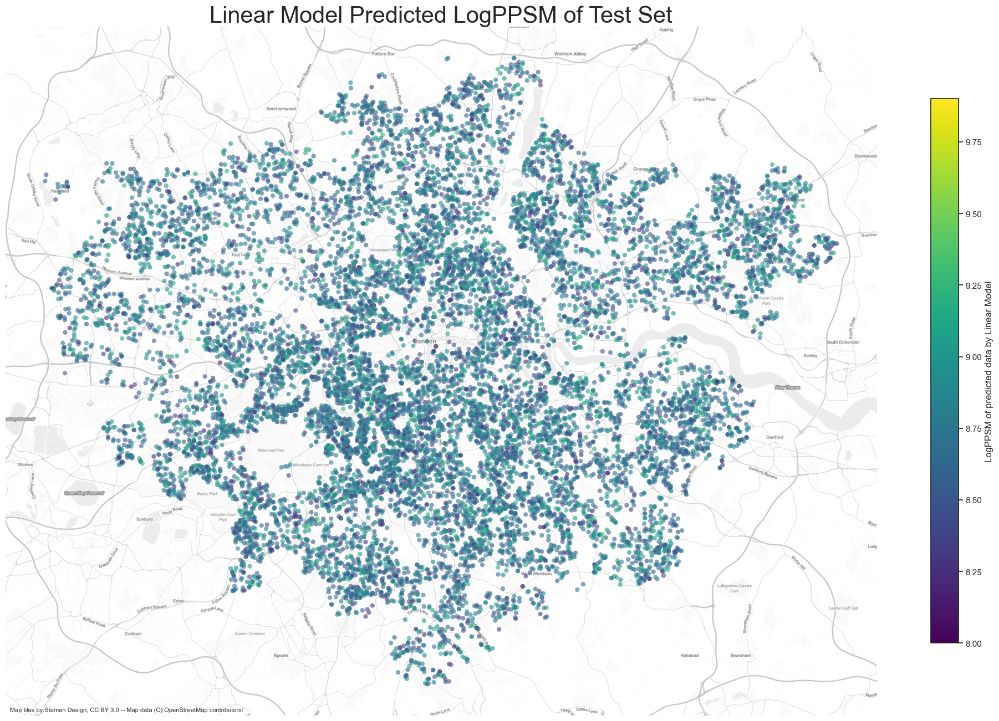

In [65]:
# this sets an empty fig and axis 
fig,ax = plt.subplots(1,1,figsize=[20,20])

# plot with geopandas.dataframe.plot
myplot=df1.plot(figsize=(20, 20), alpha=0.6, linewidth=0.1,
                edgecolor='w',ax=ax,
            column='predicted_LM_logPPSM',legend=True,vmin = 8, vmax=9.90,cmap='viridis',
           legend_kwds={'label': "LogPPSM of predicted data by Linear Model",'shrink': 0.5})

# this adds the basemap
ctx.add_basemap(ax, zoom=12, source=ctx.providers.Stamen.TonerLite,alpha=0.5)

# this sets the title
ax.set_title("Linear Model Predicted LogPPSM of Test Set",fontsize= 30)

# this removes the axis
ax.set_axis_off()

# this tightens the layout
fig.tight_layout()

plt.savefig('LM_distribution_PPSM_test.png')

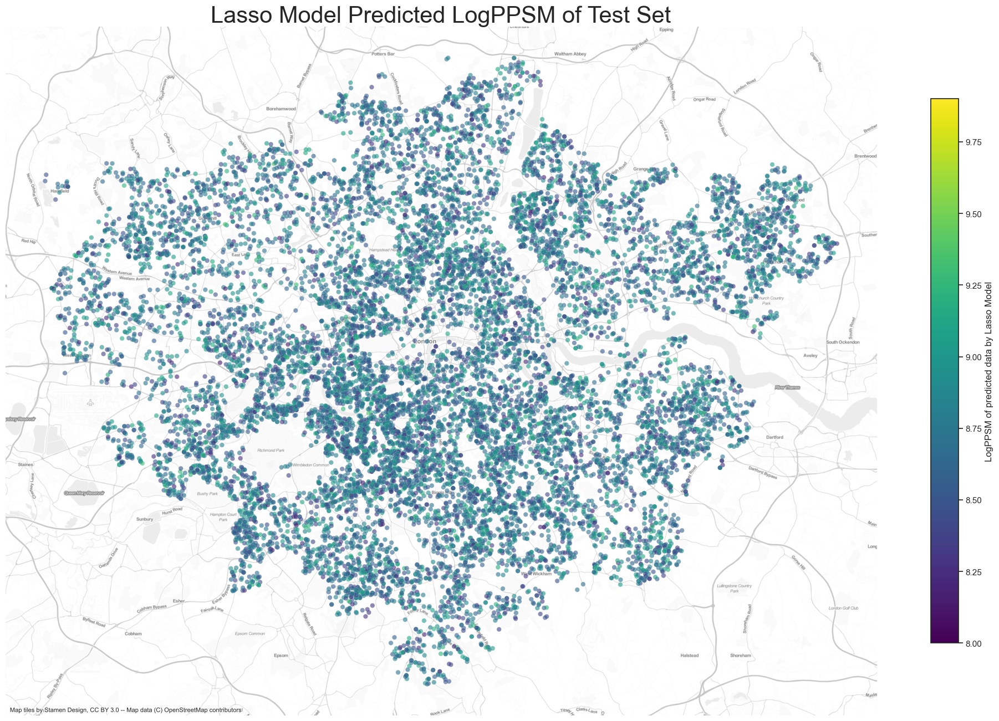

In [66]:
# this sets an empty fig and axis 
fig,ax = plt.subplots(1,1,figsize=[20,20])

# plot with geopandas.dataframe.plot
myplot=df1.plot(figsize=(20, 20), alpha=0.6, linewidth=0.1,
                edgecolor='w',ax=ax,
            column='predicted_Lasso_logPPSM',legend=True,vmin = 8, vmax=9.90,cmap='viridis',
           legend_kwds={'label': "LogPPSM of predicted data by Lasso Model",'shrink': 0.5})

# this adds the basemap
ctx.add_basemap(ax, zoom=12, source=ctx.providers.Stamen.TonerLite,alpha=0.5)

# this sets the title
ax.set_title("Lasso Model Predicted LogPPSM of Test Set",fontsize= 30)

# this removes the axis
ax.set_axis_off()

# this tightens the layout
fig.tight_layout()

plt.savefig('Lasso_distribution_PPSM_test.png')

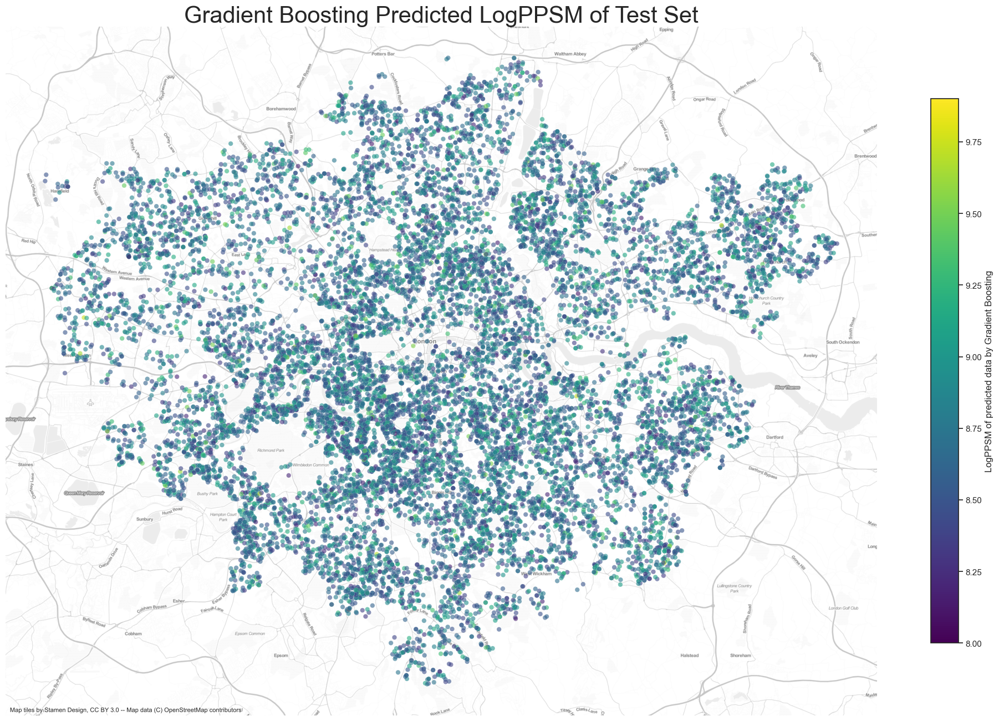

In [67]:
# this sets an empty fig and axis 
fig,ax = plt.subplots(1,1,figsize=[20,20])

# plot with geopandas.dataframe.plot
myplot=df1.plot(figsize=(20, 20), alpha=0.6, linewidth=0.1,
                edgecolor='w',ax=ax,
            column='predicted_gb_logPPSM',legend=True,vmin = 8, vmax=9.90,cmap='viridis',
           legend_kwds={'label': "LogPPSM of predicted data by Gradient Boosting",'shrink': 0.5})

# this adds the basemap
ctx.add_basemap(ax, zoom=12, source=ctx.providers.Stamen.TonerLite,alpha=0.5)

# this sets the title
ax.set_title("Gradient Boosting Predicted LogPPSM of Test Set",fontsize= 30)

# this removes the axis
ax.set_axis_off()

# this tightens the layout
fig.tight_layout()

plt.savefig('GB_distribution_PPSM_test.png')

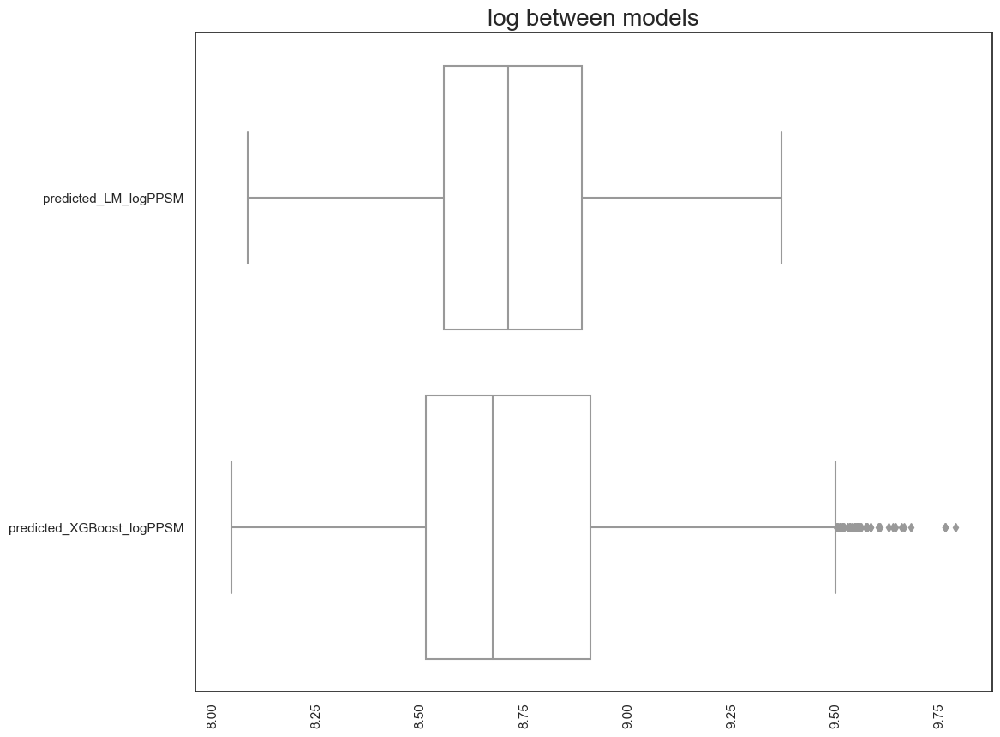

In [68]:
# Boxplot for comparing predictions xgboost and linear 
models = df1[['predicted_LM_logPPSM', 'predicted_XGBoost_logPPSM']]
plt.figure(figsize=(12,10))
plt.title('log between models',fontsize=20)
sns.boxplot(data=models,orient='h',color='white')
plt.xticks(rotation=90)
plt.show()

In [70]:
# %%time
from sklearn.ensemble import RandomForestRegressor
# model = RandomForestRegressor(n_estimators = 1000)

# tuning_parameters = {
#    'min_samples_leaf': [1, 3, 5],
#    'max_features': [2, 3, 4],
#}

#rf_search = RandomizedSearchCV(model, tuning_parameters, n_iter= 80, cv = 5, random_state=87)
#rf_search.fit(X_train, y_train)

#rf = rf_search.best_estimator_

#print('Best parameters found by randomised search:', rf_search.best_params_, '\n')
# 22min run time

In [71]:
rf = RandomForestRegressor(n_estimators=1000, max_features = 4, min_samples_leaf= 1)
rf.fit(X_train, y_train)

RandomForestRegressor(max_features=4, n_estimators=1000)

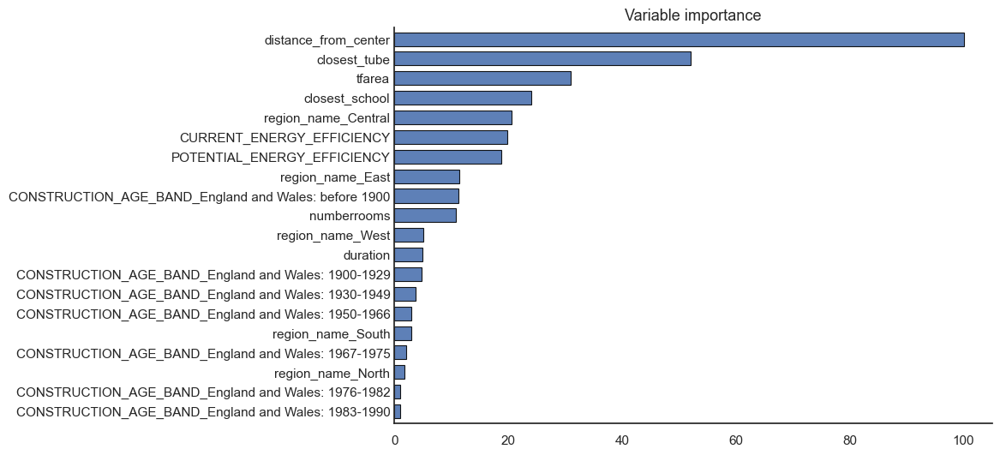

<Figure size 640x480 with 0 Axes>

In [80]:
plot_feature_importance(rf, X_train.columns)
plt.show()
plt.savefig('Variable_importance_rf.png')

In [73]:
#train set
columns=['Train RMSE', 'Train R2', 'Train MSE']
rows=['Random Forest']
results=pd.DataFrame(0.0, columns=columns, index=rows) 

methods=[rf]

for i, method in enumerate(methods):

    y_pred=method.predict(X_train)
    
    results.iloc[i,0] = (mean_squared_error(y_train, y_pred, squared = False))
    results.iloc[i,1] = r2_score(y_train, y_pred)
    results.iloc[i,2] = mean_absolute_error(y_train, y_pred)

results.round(3)

,Train RMSE,Train R2,Train MSE
Random Forest,0.0780,0.9490,0.0570


In [74]:
#test set
columns=['Test RMSE', 'Test R2', 'Test MSE']
rows=['Random Forest']
results=pd.DataFrame(0.0, columns=columns, index=rows) 

methods=[rf]

for i, method in enumerate(methods):

    y_pred=method.predict(X_test)
    
    results.iloc[i,0] = (mean_squared_error(y_test, y_pred, squared = False))
    results.iloc[i,1] = r2_score(y_test, y_pred)
    results.iloc[i,2] = mean_absolute_error(y_test, y_pred)

results.round(3)

,Test RMSE,Test R2,Test MSE
Random Forest,0.2100,0.6370,0.1540


In [75]:
#Testing set all methods together
columns=['Test RMSE', 'Test R2', 'Test MSE']
rows=['Linear Regression', 'Lasso Regression', 'Gradient Boosting', 'XGBoost', 'Random Forest']
results=pd.DataFrame(0.0, columns=columns, index=rows) 

methods = [model, model2, gb, xbst, rf]

for i, method in enumerate(methods):

    y_pred=method.predict(X_test)
    
    results.iloc[i,0] = (mean_squared_error(y_test, y_pred, squared=False))
    results.iloc[i,1] = r2_score(y_test, y_pred)
    results.iloc[i,2] = mean_absolute_error(y_test, y_pred)

results.round(4)

,Test RMSE,Test R2,Test MSE
Linear Regression,0.2524,0.4768,0.1928
Lasso Regression,0.2524,0.4768,0.1928
Gradient Boosting,0.2102,0.6371,0.1549
XGBoost,0.2099,0.6382,0.1546
Random Forest,0.2104,0.6365,0.1539


In [77]:
#Testing set all methods together (for training subsets)
columns=['Train RMSE', 'Train R2', 'Train MSE']
rows=['Linear Regression', 'Lasso Regression', 'Gradient Boosting', 'XGBoost', 'Random Forest']
results=pd.DataFrame(0.0, columns=columns, index=rows) 

methods = [model, model2, gb, xbst, rf]

for i, method in enumerate(methods):

    y_pred=method.predict(X_train)
    
    results.iloc[i,0] = (mean_squared_error(y_train, y_pred, squared=False))
    results.iloc[i,1] = r2_score(y_train, y_pred)
    results.iloc[i,2] = mean_absolute_error(y_train, y_pred)

results.round(4)

,Train RMSE,Train R2,Train MSE
Linear Regression,0.2533,0.4665,0.1933
Lasso Regression,0.2533,0.4665,0.1933
Gradient Boosting,0.1811,0.7273,0.1355
XGBoost,0.1841,0.7183,0.1365
Random Forest,0.0784,0.9490,0.0572
